In [1]:
%matplotlib inline

import os
import pandas as pd
import numpy as np
from scipy.io import mmread
import scipy.sparse as sp
import matplotlib.pyplot as plt
from IPython.display import Image
import scanpy as sc
from cnmf import cNMF
    
np.random.seed(14)

os.chdir('/Users/dylanschaff/Library/CloudStorage/GoogleDrive-dyschaff@sydshafferlab.com/My Drive/Schaff_Shared/Cloud/Schaff_paper/NMF')

# Much of this code follwoed the cNMF vignette https://github.com/dylkot/cNMF/blob/master/Tutorials/analyze_pbmc_example_data.ipynb

Load in the naive data and look at stats

/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/anndata/compat/__init__.py:235: FutureWarning: Moving element from .uns['neighbors']['distances'] to .obsp['distances'].

This is where adjacency matrices should go now.
  FutureWarning,


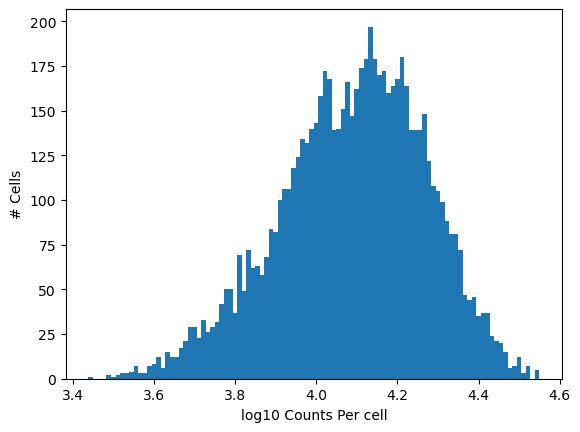

In [110]:
# Load in the naive data
naive = sc.read_h5ad('naive.h5ad')
## plot log10 # counts per cell
plt.hist(np.log10(naive.obs['nCount_RNA']), bins=100)
_ = plt.xlabel('log10 Counts Per cell')
_ = plt.ylabel('# Cells')

if not os.path.exists('naive'):
    os.mkdir('naive')

naive.layers['counts'] = naive.raw.X.copy()
naive.layers['log1p'] = naive.X.copy()

count_adat_fn = 'naive/naive_counts.h5ad'
sc.write(count_adat_fn, naive)

In [111]:
naive_dense_data = pd.DataFrame(naive.layers['counts'].todense(), index=naive.obs.index, columns=naive.var.index).astype(int)
naive_dense_data.head()
count_txt_fn = 'naive/counts.tsv'
naive_dense_data.to_csv(count_txt_fn, sep='\t')

In [112]:
numiter=200 # Number of NMF replicates. Set this to a larger value ~200 for real data. We set this to a relatively low value here for illustration at a faster speed
numhvgenes=5000 ## Number of over-dispersed genes to use for running the actual factorizations

## Results will be saved to [output_directory]/[run_name] which in this example is example_PBMC/cNMF/pbmc_cNMF
output_directory = 'naive'
if not os.path.exists(output_directory):
    os.mkdir(output_directory)
run_name = 'naive_cNMF'

## Specify the Ks to use as a space separated list in this case "2 3 4 5 6 7 8 9 10"
K = ' '.join([str(i) for i in range(2,16)])

## To speed this up, you can run it for only K=7-8 with the option below
#K = ' '.join([str(i) for i in range(7,9)])


seed = 14 ## Specify a seed pseudorandom number generation for reproducibility

## Path to the filtered counts dataset we output previously
countfn = 'naive/naive_counts.h5ad'


In [113]:
## Initialize the cnmf object that will be used to run analyses
naive_cnmf_obj = cNMF(output_dir=output_directory, name=run_name)

In [114]:
## Prepare the data, I.e. subset to 5000 high-variance genes, and variance normalize
naive_cnmf_obj.prepare(counts_fn=count_txt_fn, components=np.arange(2,16), n_iter=200, seed=14, num_highvar_genes=5000)

/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/cnmf/cnmf.py:327: FutureWarning: X.dtype being converted to np.float32 from int64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  var=pd.DataFrame(index=input_counts.columns))
/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


In [115]:
## Specify that the jobs are being distributed over a single worker (total_workers=1) and then launch that worker
naive_cnmf_obj.factorize(worker_i=0, total_workers=1)

[Worker 0]. Starting task 0.
[Worker 0]. Starting task 1.
[Worker 0]. Starting task 2.
[Worker 0]. Starting task 3.
[Worker 0]. Starting task 4.
[Worker 0]. Starting task 5.
[Worker 0]. Starting task 6.
[Worker 0]. Starting task 7.
[Worker 0]. Starting task 8.
[Worker 0]. Starting task 9.
[Worker 0]. Starting task 10.
[Worker 0]. Starting task 11.
[Worker 0]. Starting task 12.
[Worker 0]. Starting task 13.
[Worker 0]. Starting task 14.
[Worker 0]. Starting task 15.
[Worker 0]. Starting task 16.
[Worker 0]. Starting task 17.
[Worker 0]. Starting task 18.
[Worker 0]. Starting task 19.
[Worker 0]. Starting task 20.
[Worker 0]. Starting task 21.
[Worker 0]. Starting task 22.
[Worker 0]. Starting task 23.
[Worker 0]. Starting task 24.
[Worker 0]. Starting task 25.
[Worker 0]. Starting task 26.
[Worker 0]. Starting task 27.
[Worker 0]. Starting task 28.
[Worker 0]. Starting task 29.
[Worker 0]. Starting task 30.
[Worker 0]. Starting task 31.
[Worker 0]. Starting task 32.
[Worker 0]. Starting

In [116]:
# Combine the individual factorizations
naive_cnmf_obj.combine()

Combining factorizations for k=2.
Combining factorizations for k=3.
Combining factorizations for k=4.
Combining factorizations for k=5.
Combining factorizations for k=6.
Combining factorizations for k=7.
Combining factorizations for k=8.
Combining factorizations for k=9.
Combining factorizations for k=10.
Combining factorizations for k=11.
Combining factorizations for k=12.
Combining factorizations for k=13.
Combining factorizations for k=14.
Combining factorizations for k=15.


This saves the corresponding figure to the following file: naive/naive_cNMF/naive_cNMF.k_selection.png


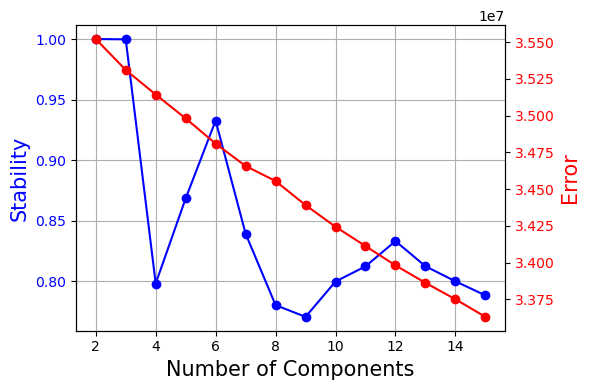

In [117]:
# Compute the stability at each choice of K to see if a clear choice jumps out
naive_cnmf_obj.k_selection_plot(close_fig=False)
print('This saves the corresponding figure to the following file: %s' % naive_cnmf_obj.paths['k_selection_plot'])

/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/cnmf/cnmf.py:835: RuntimeWarning: invalid value encountered in true_divide
  norm_tpm = (np.array(tpm.X.todense()) - tpm_stats['__mean'].values) / tpm_stats['__std'].values
/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


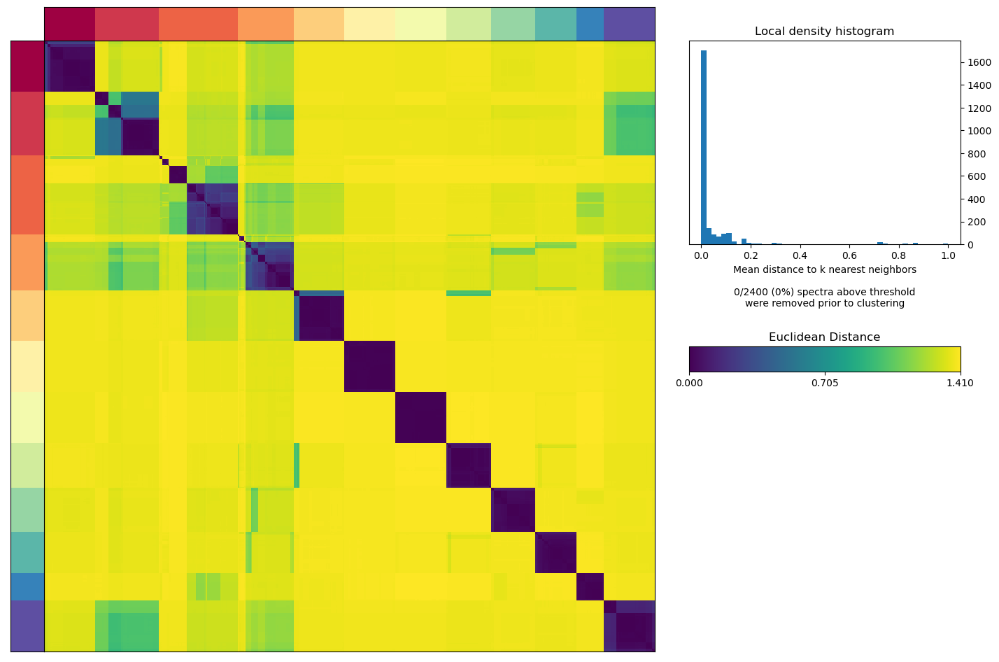

In [122]:
#find k with best stability
selected_K = 12 # was 6
density_threshold = 2.00   
naive_cnmf_obj.consensus(k=selected_K, density_threshold=density_threshold, show_clustering=True, close_clustergram_fig=False)


/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/cnmf/cnmf.py:835: RuntimeWarning: invalid value encountered in true_divide
  norm_tpm = (np.array(tpm.X.todense()) - tpm_stats['__mean'].values) / tpm_stats['__std'].values
/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


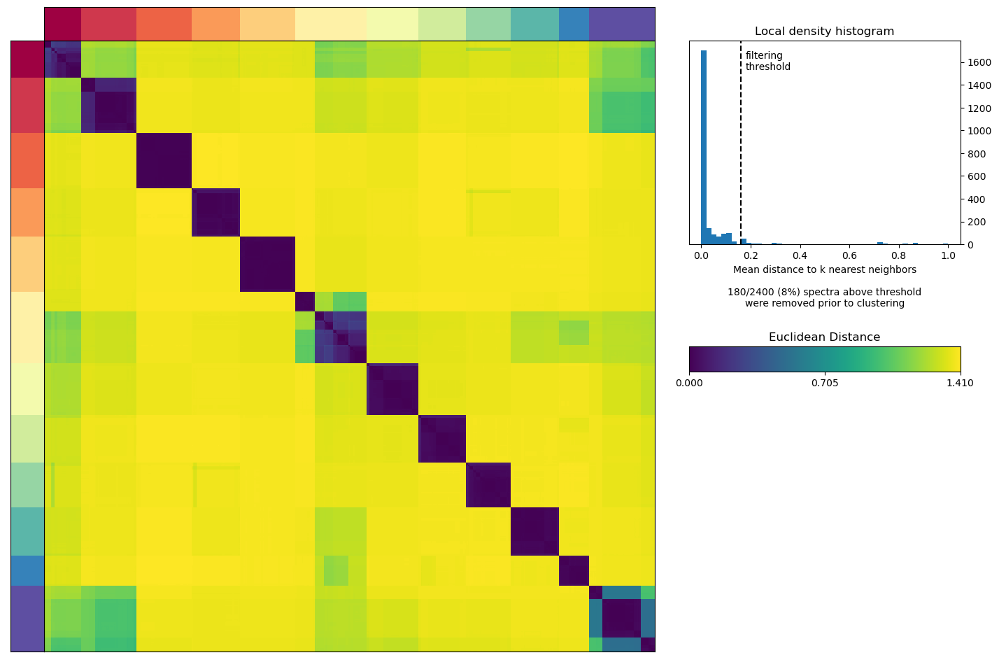

In [124]:
# Try increasingly stringent filters
density_threshold = 0.16
naive_cnmf_obj.consensus(k=selected_K, density_threshold=density_threshold, show_clustering=True, close_clustergram_fig=False)


In [125]:
## Obtain high variance genes that were used for cNMF as these were saved to a text file
hvgs = open('./naive/naive_cNMF/naive_cNMF.overdispersed_genes.txt').read().split('\n')

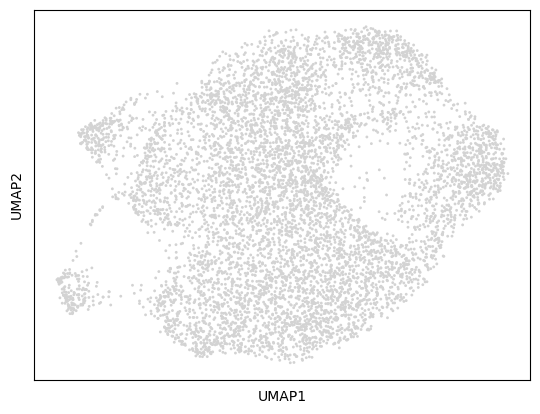

In [126]:
# Verify that the the naive umap is plotting correctly
sc.pl.umap(naive)

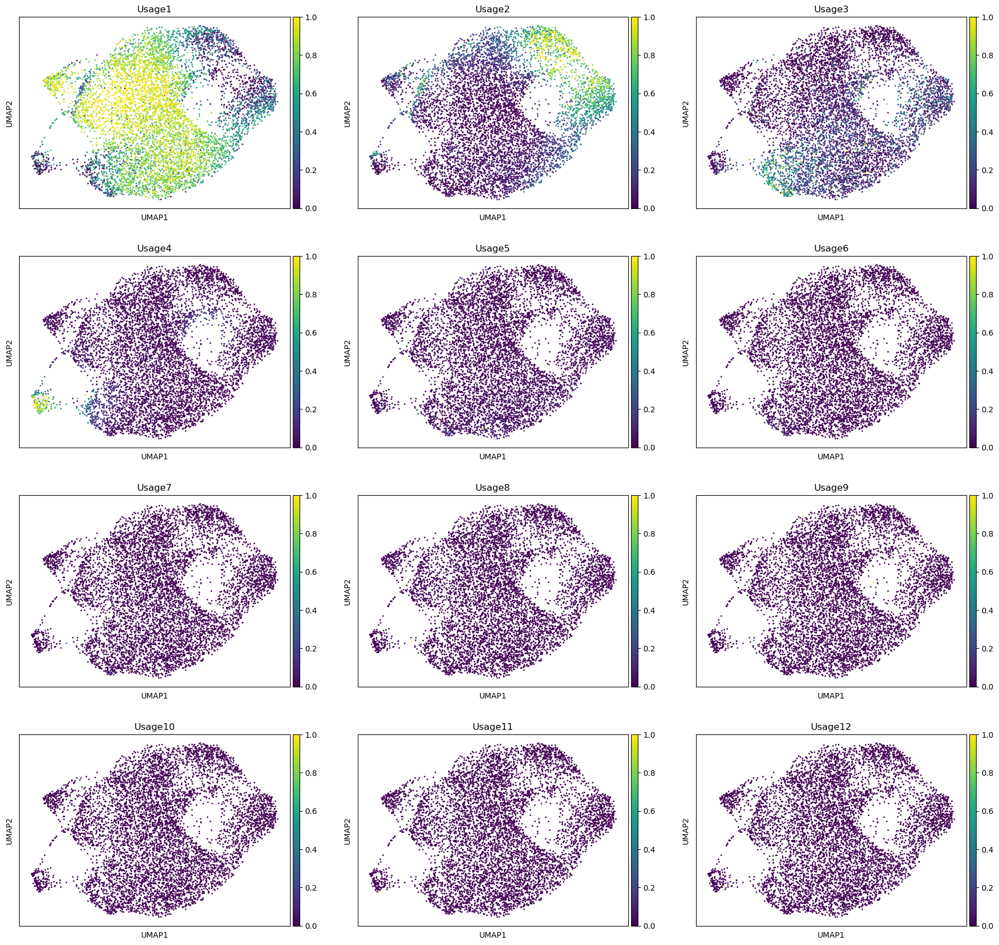

In [134]:
# We can load the results for a cNMF run with a given K and density filtering threshold like below
usage_norm, gep_scores, gep_tpm, topgenes = naive_cnmf_obj.load_results(K=selected_K, density_threshold=density_threshold)
usage_norm.columns = ['Usage%d' % i for i in usage_norm.columns]

gep_scores.to_csv('naive/naive_gep_scores.txt', sep='\t', index = True)

# Lets look at how the normalized usages segregate on the UMAP
naive.obs = pd.merge(left=naive.obs, right=usage_norm, how='left', left_index=True, right_index=True)

sc.pl.umap(naive, color=usage_norm.columns,
           use_raw=True, ncols=3, vmin=0, vmax=1)

In [136]:
top_genes = []
ngenes = 100
for gep in gep_scores.columns:
    top_genes.append(list(gep_scores.sort_values(by=gep, ascending=False).index[:ngenes]))
    
top_genes = pd.DataFrame(top_genes, index=gep_scores.columns).T
top_genes

topgenes.to_csv('naive/naive_topgenes.txt', sep='\t', index = False)


Load in the dab data and look at stats

/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/anndata/compat/__init__.py:235: FutureWarning: Moving element from .uns['neighbors']['distances'] to .obsp['distances'].

This is where adjacency matrices should go now.
  FutureWarning,
/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/cnmf/cnmf.py:327: FutureWarning: X.dtype being converted to np.float32 from int64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  var=pd.DataFrame(index=input_counts.columns))
/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


[Worker 0]. Starting task 0.
[Worker 0]. Starting task 1.
[Worker 0]. Starting task 2.
[Worker 0]. Starting task 3.
[Worker 0]. Starting task 4.
[Worker 0]. Starting task 5.
[Worker 0]. Starting task 6.
[Worker 0]. Starting task 7.
[Worker 0]. Starting task 8.
[Worker 0]. Starting task 9.
[Worker 0]. Starting task 10.
[Worker 0]. Starting task 11.
[Worker 0]. Starting task 12.
[Worker 0]. Starting task 13.
[Worker 0]. Starting task 14.
[Worker 0]. Starting task 15.
[Worker 0]. Starting task 16.
[Worker 0]. Starting task 17.
[Worker 0]. Starting task 18.
[Worker 0]. Starting task 19.
[Worker 0]. Starting task 20.
[Worker 0]. Starting task 21.
[Worker 0]. Starting task 22.
[Worker 0]. Starting task 23.
[Worker 0]. Starting task 24.
[Worker 0]. Starting task 25.
[Worker 0]. Starting task 26.
[Worker 0]. Starting task 27.
[Worker 0]. Starting task 28.
[Worker 0]. Starting task 29.
[Worker 0]. Starting task 30.
[Worker 0]. Starting task 31.
[Worker 0]. Starting task 32.
[Worker 0]. Starting

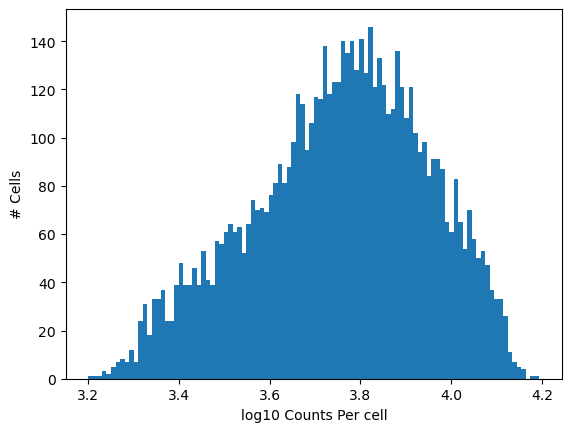

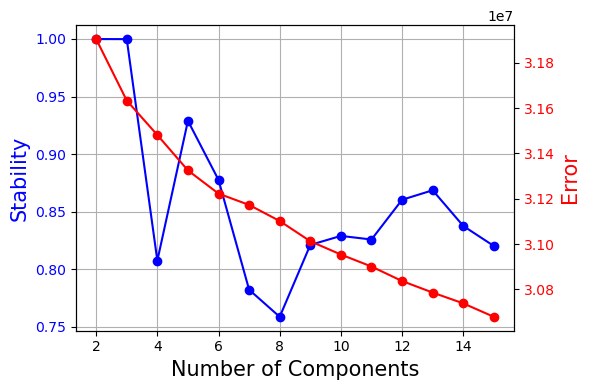

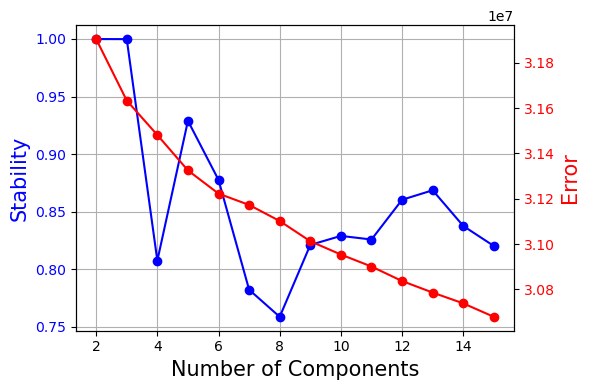

In [2]:
# Load in the naive data
dab = sc.read_h5ad('dab.h5ad')
## plot log10 # counts per cell
plt.hist(np.log10(dab.obs['nCount_RNA']), bins=100)
_ = plt.xlabel('log10 Counts Per cell')
_ = plt.ylabel('# Cells')

if not os.path.exists('dab'):
    os.mkdir('dab')

dab.layers['counts'] = dab.raw.X.copy()
dab.layers['log1p'] = dab.X.copy()

count_adat_fn = 'dab/dab_counts.h5ad'
sc.write(count_adat_fn, dab)


dab_dense_data = pd.DataFrame(dab.layers['counts'].todense(), index=dab.obs.index, columns=dab.var.index).astype(int)
dab_dense_data.head()
count_txt_fn = 'dab/counts.tsv'
dab_dense_data.to_csv(count_txt_fn, sep='\t')

numiter=200 # Number of NMF replicates. Set this to a larger value ~200 for real data. We set this to a relatively low value here for illustration at a faster speed
numhvgenes=5000 ## Number of over-dispersed genes to use for running the actual factorizations

## Results will be saved to [output_directory]/[run_name] which in this example is example_PBMC/cNMF/pbmc_cNMF
output_directory = 'dab'
if not os.path.exists(output_directory):
    os.mkdir(output_directory)
run_name = 'dab_cNMF'

## Specify the Ks to use as a space separated list in this case "2 3 4 5 6 7 8 9 10"
K = ' '.join([str(i) for i in range(2,16)])

## To speed this up, you can run it for only K=7-8 with the option below
#K = ' '.join([str(i) for i in range(7,9)])


seed = 14 ## Specify a seed pseudorandom number generation for reproducibility

## Path to the filtered counts dataset we output previously
countfn = 'dab/dab_counts.h5ad'

## Initialize the cnmf object that will be used to run analyses
dab_cnmf_obj = cNMF(output_dir=output_directory, name=run_name)

## Prepare the data, I.e. subset to 5000 high-variance genes, and variance normalize
dab_cnmf_obj.prepare(counts_fn=count_txt_fn, components=np.arange(2,16), n_iter=200, seed=14, num_highvar_genes=5000)

## Specify that the jobs are being distributed over a single worker (total_workers=1) and then launch that worker
dab_cnmf_obj.factorize(worker_i=0, total_workers=1)

# Combine the individual factorizations
dab_cnmf_obj.combine()
# Compute the stability at each choice of K to see if a clear choice jumps out
dab_cnmf_obj.k_selection_plot(close_fig=False)

print('This saves the corresponding figure to the following file: %s' % dab_cnmf_obj.paths['k_selection_plot'])
# Combine the individual factorizations
dab_cnmf_obj.combine()

# Compute the stability at each choice of K to see if a clear choice jumps out
dab_cnmf_obj.k_selection_plot(close_fig=False)
print('This saves the corresponding figure to the following file: %s' % dab_cnmf_obj.paths['k_selection_plot'])

/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/cnmf/cnmf.py:835: RuntimeWarning: invalid value encountered in true_divide
  norm_tpm = (np.array(tpm.X.todense()) - tpm_stats['__mean'].values) / tpm_stats['__std'].values
/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


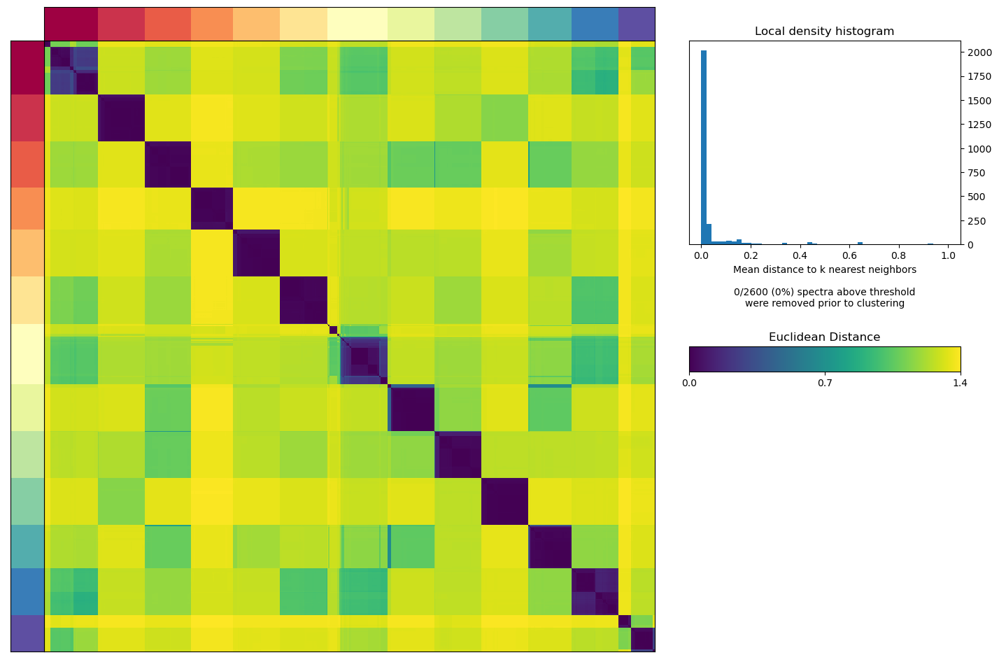

In [3]:
#find k with best stability
selected_K = 13 # was 5
density_threshold = 2.00   
dab_cnmf_obj.consensus(k=selected_K, density_threshold=density_threshold, show_clustering=True, close_clustergram_fig=False)

/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/cnmf/cnmf.py:835: RuntimeWarning: invalid value encountered in true_divide
  norm_tpm = (np.array(tpm.X.todense()) - tpm_stats['__mean'].values) / tpm_stats['__std'].values
/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


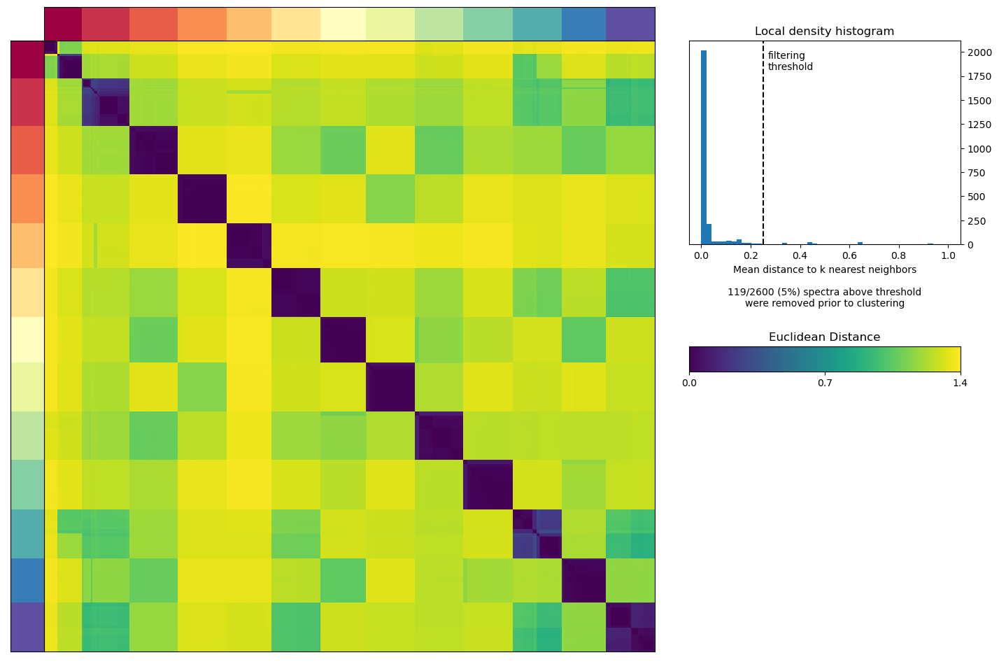

In [4]:
# Try increasingly stringent filters
density_threshold = 0.25
dab_cnmf_obj.consensus(k=selected_K, density_threshold=density_threshold, show_clustering=True, close_clustergram_fig=False)


In [5]:
## Obtain high variance genes that were used for cNMF as these were saved to a text file
dab_hvgs = open('./dab/dab_cNMF/dab_cNMF.overdispersed_genes.txt').read().split('\n')

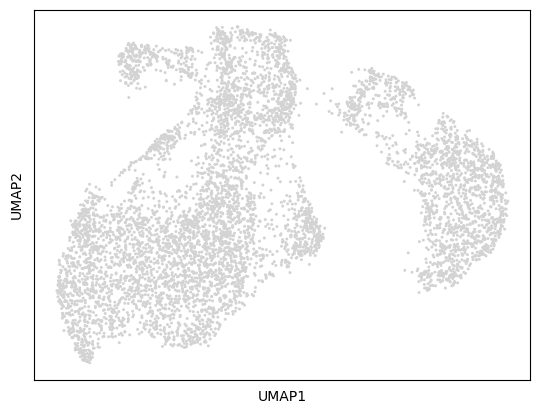

In [6]:
# Verify that the the naive umap is plotting correctly
sc.pl.umap(dab)

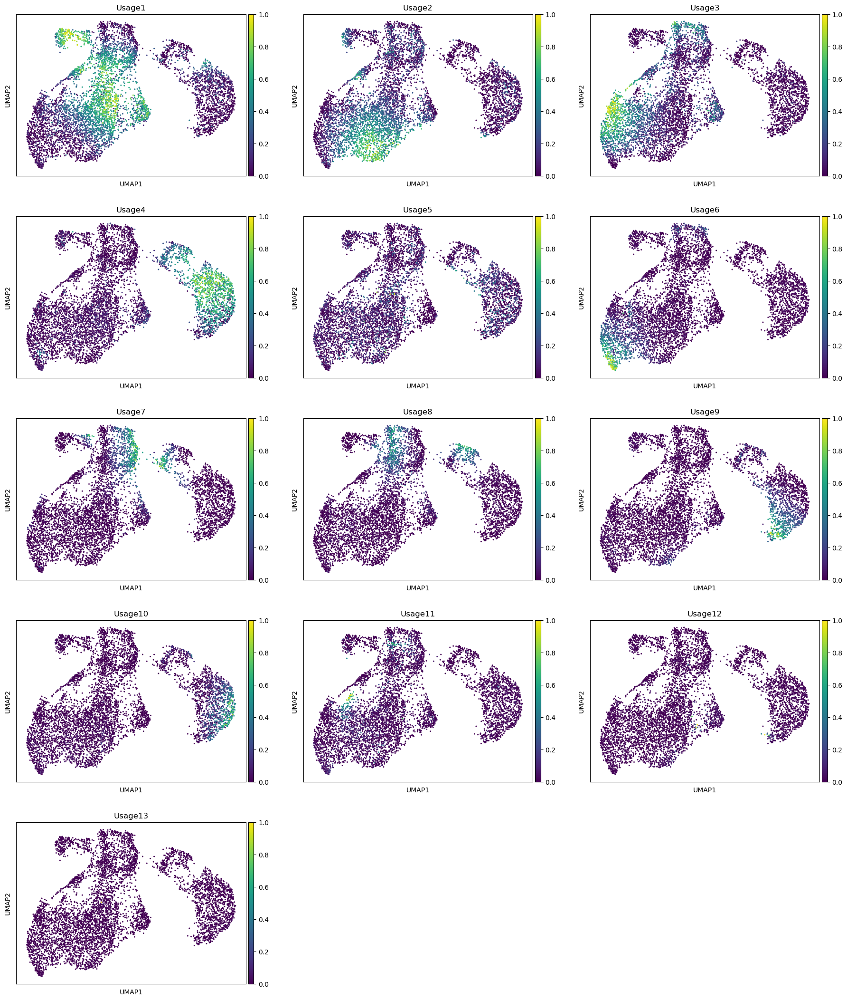

In [7]:
# We can load the results for a cNMF run with a given K and density filtering threshold like below
usage_norm, gep_scores, gep_tpm, topgenes = dab_cnmf_obj.load_results(K=selected_K, density_threshold=density_threshold)
usage_norm.columns = ['Usage%d' % i for i in usage_norm.columns]

gep_scores.to_csv('dab/dab_gep_scores.txt', sep='\t', index = True)

# Lets look at how the normalized usages segregate on the UMAP
dab.obs = pd.merge(left=dab.obs, right=usage_norm, how='left', left_index=True, right_index=True)

sc.pl.umap(dab, color=usage_norm.columns,
           use_raw=True, ncols=3, vmin=0, vmax=1)

In [8]:
top_genes = []
ngenes = 100
for gep in gep_scores.columns:
    top_genes.append(list(gep_scores.sort_values(by=gep, ascending=False).index[:ngenes]))
    
top_genes = pd.DataFrame(top_genes, index=gep_scores.columns).T
top_genes

topgenes.to_csv('dab/dab_topgenes.txt', sep='\t', index = False)

Trametinib

/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/anndata/compat/__init__.py:235: FutureWarning: Moving element from .uns['neighbors']['distances'] to .obsp['distances'].

This is where adjacency matrices should go now.
  FutureWarning,
/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/cnmf/cnmf.py:327: FutureWarning: X.dtype being converted to np.float32 from int64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  var=pd.DataFrame(index=input_counts.columns))
/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


[Worker 0]. Starting task 0.
[Worker 0]. Starting task 1.
[Worker 0]. Starting task 2.
[Worker 0]. Starting task 3.
[Worker 0]. Starting task 4.
[Worker 0]. Starting task 5.
[Worker 0]. Starting task 6.
[Worker 0]. Starting task 7.
[Worker 0]. Starting task 8.
[Worker 0]. Starting task 9.
[Worker 0]. Starting task 10.
[Worker 0]. Starting task 11.
[Worker 0]. Starting task 12.
[Worker 0]. Starting task 13.
[Worker 0]. Starting task 14.
[Worker 0]. Starting task 15.
[Worker 0]. Starting task 16.
[Worker 0]. Starting task 17.
[Worker 0]. Starting task 18.
[Worker 0]. Starting task 19.
[Worker 0]. Starting task 20.
[Worker 0]. Starting task 21.
[Worker 0]. Starting task 22.
[Worker 0]. Starting task 23.
[Worker 0]. Starting task 24.
[Worker 0]. Starting task 25.
[Worker 0]. Starting task 26.
[Worker 0]. Starting task 27.
[Worker 0]. Starting task 28.
[Worker 0]. Starting task 29.
[Worker 0]. Starting task 30.
[Worker 0]. Starting task 31.
[Worker 0]. Starting task 32.
[Worker 0]. Starting

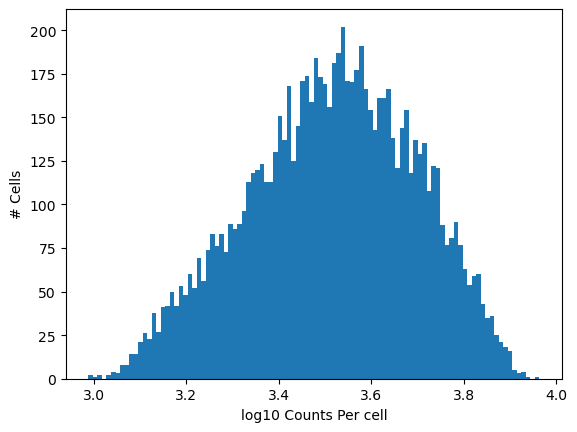

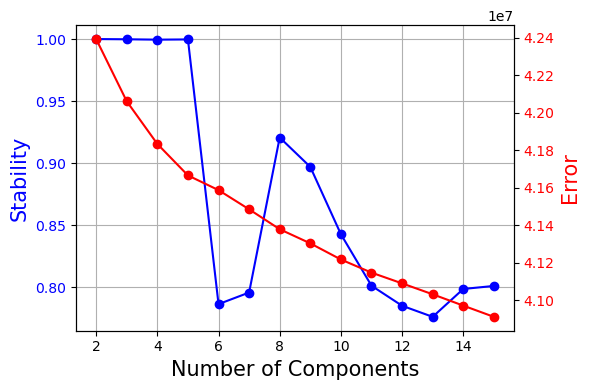

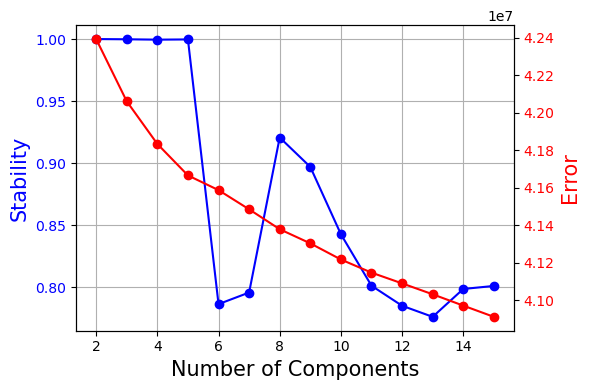

In [119]:
# Load in the naive data
tram = sc.read_h5ad('tram.h5ad')
## plot log10 # counts per cell
plt.hist(np.log10(tram.obs['nCount_RNA']), bins=100)
_ = plt.xlabel('log10 Counts Per cell')
_ = plt.ylabel('# Cells')

if not os.path.exists('tram'):
    os.mkdir('tram')

tram.layers['counts'] = tram.raw.X.copy()
tram.layers['log1p'] = tram.X.copy()

count_adat_fn = 'tram/tram_counts.h5ad'
sc.write(count_adat_fn, tram)


tram_dense_data = pd.DataFrame(tram.layers['counts'].todense(), index=tram.obs.index, columns=tram.var.index).astype(int)
tram_dense_data.head()
count_txt_fn = 'tram/counts.tsv'
tram_dense_data.to_csv(count_txt_fn, sep='\t')

numiter=200 # Number of NMF replicates. Set this to a larger value ~200 for real data. We set this to a relatively low value here for illustration at a faster speed
numhvgenes=5000 ## Number of over-dispersed genes to use for running the actual factorizations

## Results will be saved to [output_directory]/[run_name] which in this example is example_PBMC/cNMF/pbmc_cNMF
output_directory = 'tram'
if not os.path.exists(output_directory):
    os.mkdir(output_directory)
run_name = 'tram_cNMF'

## Specify the Ks to use as a space separated list in this case "2 3 4 5 6 7 8 9 10"
K = ' '.join([str(i) for i in range(2,16)])

## To speed this up, you can run it for only K=7-8 with the option below
#K = ' '.join([str(i) for i in range(7,9)])


seed = 14 ## Specify a seed pseudorandom number generation for reproducibility

## Path to the filtered counts dataset we output previously
countfn = 'tram/tram_counts.h5ad'

## Initialize the cnmf object that will be used to run analyses
tram_cnmf_obj = cNMF(output_dir=output_directory, name=run_name)

## Prepare the data, I.e. subset to 5000 high-variance genes, and variance normalize
tram_cnmf_obj.prepare(counts_fn=count_txt_fn, components=np.arange(2,16), n_iter=200, seed=14, num_highvar_genes=5000)

## Specify that the jobs are being distributed over a single worker (total_workers=1) and then launch that worker
tram_cnmf_obj.factorize(worker_i=0, total_workers=1)

# Combine the individual factorizations
tram_cnmf_obj.combine()
# Compute the stability at each choice of K to see if a clear choice jumps out
tram_cnmf_obj.k_selection_plot(close_fig=False)

print('This saves the corresponding figure to the following file: %s' % tram_cnmf_obj.paths['k_selection_plot'])
# Combine the individual factorizations
tram_cnmf_obj.combine()

# Compute the stability at each choice of K to see if a clear choice jumps out
tram_cnmf_obj.k_selection_plot(close_fig=False)
print('This saves the corresponding figure to the following file: %s' % tram_cnmf_obj.paths['k_selection_plot'])

/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/cnmf/cnmf.py:835: RuntimeWarning: invalid value encountered in true_divide
  norm_tpm = (np.array(tpm.X.todense()) - tpm_stats['__mean'].values) / tpm_stats['__std'].values
/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


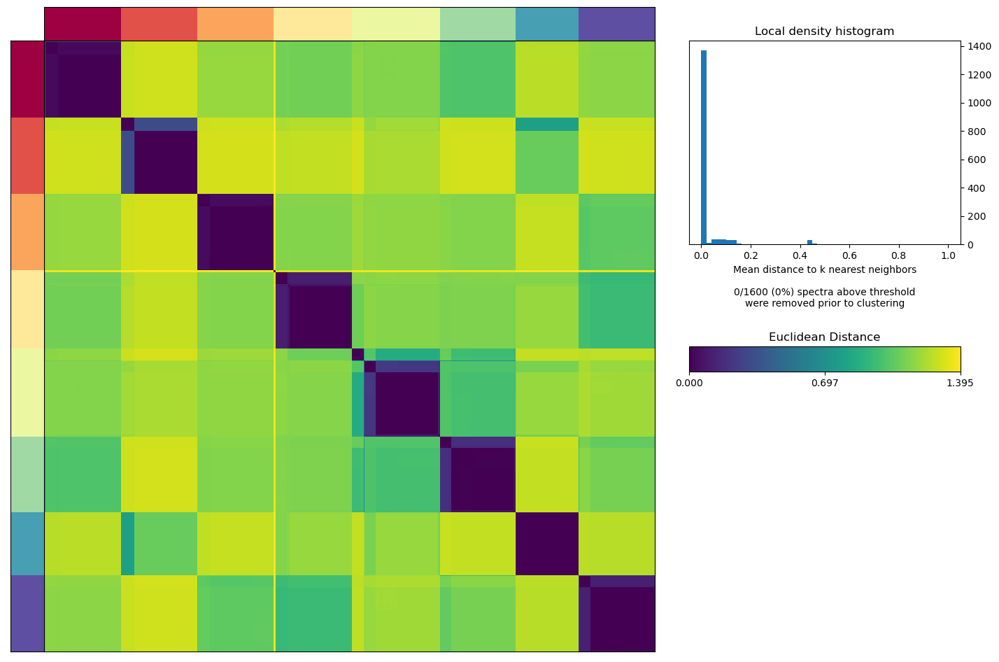

In [147]:
#find k with best stability
selected_K = 8
density_threshold = 2.00   
tram_cnmf_obj.consensus(k=selected_K, density_threshold=density_threshold, show_clustering=True, close_clustergram_fig=False)


/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/cnmf/cnmf.py:835: RuntimeWarning: invalid value encountered in true_divide
  norm_tpm = (np.array(tpm.X.todense()) - tpm_stats['__mean'].values) / tpm_stats['__std'].values
/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


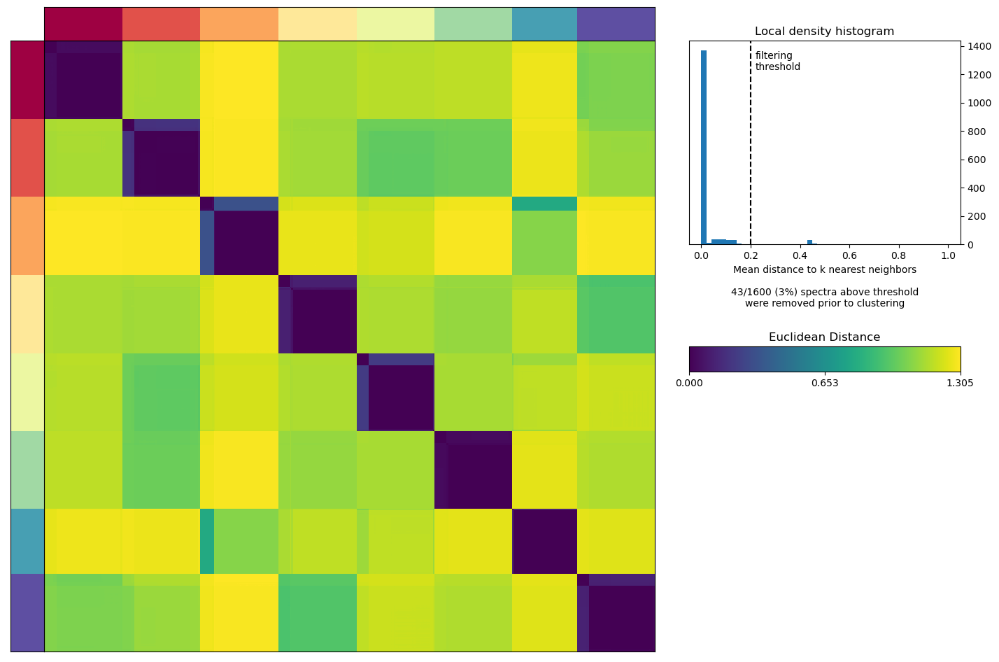

In [148]:
# Try increasingly stringent filters
density_threshold = 0.20
tram_cnmf_obj.consensus(k=selected_K, density_threshold=density_threshold, show_clustering=True, close_clustergram_fig=False)



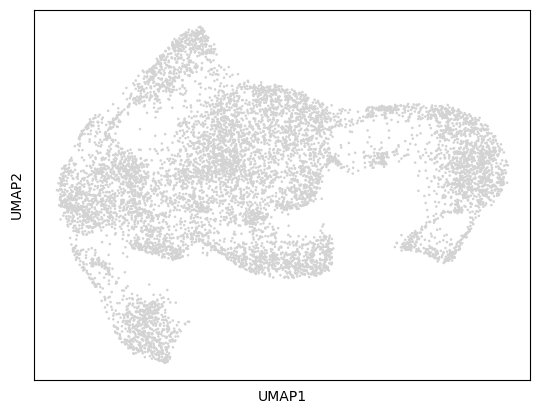

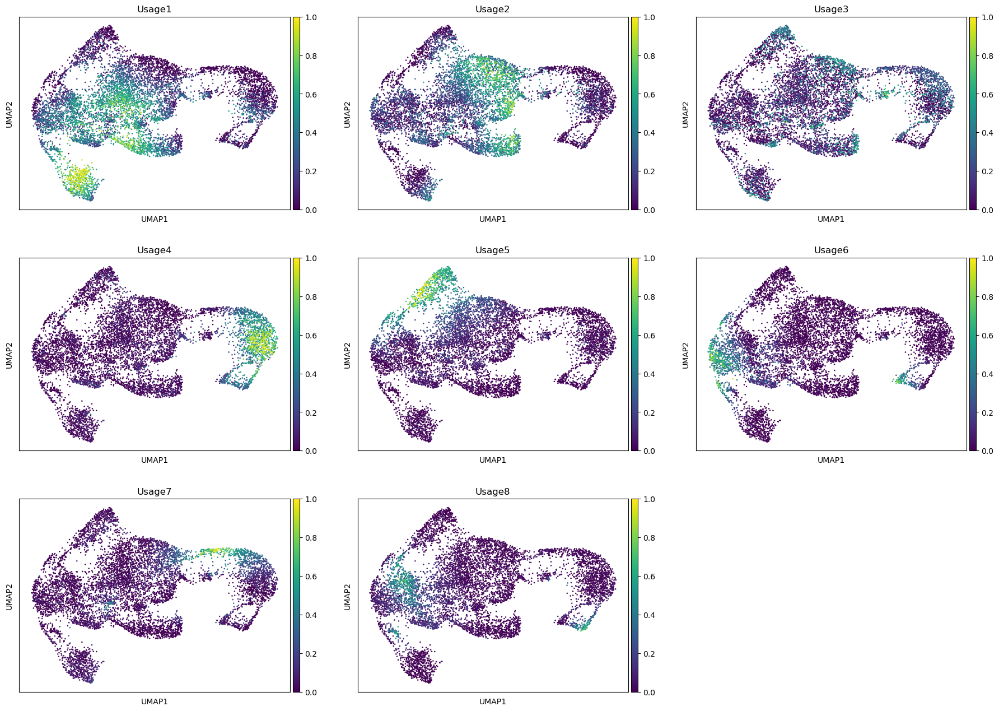

In [149]:
## Obtain high variance genes that were used for cNMF as these were saved to a text file
tram_hvgs = open('./tram/tram_cNMF/tram_cNMF.overdispersed_genes.txt').read().split('\n')
# Verify that the the naive umap is plotting correctly
sc.pl.umap(tram)
# We can load the results for a cNMF run with a given K and density filtering threshold like below
usage_norm, gep_scores, gep_tpm, topgenes = tram_cnmf_obj.load_results(K=selected_K, density_threshold=density_threshold)
usage_norm.columns = ['Usage%d' % i for i in usage_norm.columns]

gep_scores.to_csv('tram/tram_gep_scores.txt', sep='\t', index = True)

# Lets look at how the normalized usages segregate on the UMAP
tram.obs = pd.merge(left=tram.obs, right=usage_norm, how='left', left_index=True, right_index=True)

sc.pl.umap(tram, color=usage_norm.columns,
           use_raw=True, ncols=3, vmin=0, vmax=1)
top_genes = []
ngenes = 100
for gep in gep_scores.columns:
    top_genes.append(list(gep_scores.sort_values(by=gep, ascending=False).index[:ngenes]))
    
top_genes = pd.DataFrame(top_genes, index=gep_scores.columns).T
top_genes

topgenes.to_csv('tram/tram_topgenes.txt', sep='\t', index = False)

In [97]:
# Save object with nmf information
sc.write('tram/tram_nmf.h5ad', tram)

CoCl2

/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/anndata/compat/__init__.py:235: FutureWarning: Moving element from .uns['neighbors']['distances'] to .obsp['distances'].

This is where adjacency matrices should go now.
  FutureWarning,
/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/cnmf/cnmf.py:327: FutureWarning: X.dtype being converted to np.float32 from int64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  var=pd.DataFrame(index=input_counts.columns))
/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


[Worker 0]. Starting task 0.
[Worker 0]. Starting task 1.
[Worker 0]. Starting task 2.
[Worker 0]. Starting task 3.
[Worker 0]. Starting task 4.
[Worker 0]. Starting task 5.
[Worker 0]. Starting task 6.
[Worker 0]. Starting task 7.
[Worker 0]. Starting task 8.
[Worker 0]. Starting task 9.
[Worker 0]. Starting task 10.
[Worker 0]. Starting task 11.
[Worker 0]. Starting task 12.
[Worker 0]. Starting task 13.
[Worker 0]. Starting task 14.
[Worker 0]. Starting task 15.
[Worker 0]. Starting task 16.
[Worker 0]. Starting task 17.
[Worker 0]. Starting task 18.
[Worker 0]. Starting task 19.
[Worker 0]. Starting task 20.
[Worker 0]. Starting task 21.
[Worker 0]. Starting task 22.
[Worker 0]. Starting task 23.
[Worker 0]. Starting task 24.
[Worker 0]. Starting task 25.
[Worker 0]. Starting task 26.
[Worker 0]. Starting task 27.
[Worker 0]. Starting task 28.
[Worker 0]. Starting task 29.
[Worker 0]. Starting task 30.
[Worker 0]. Starting task 31.
[Worker 0]. Starting task 32.
[Worker 0]. Starting

/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 1493.
[Worker 0]. Starting task 1494.
[Worker 0]. Starting task 1495.
[Worker 0]. Starting task 1496.
[Worker 0]. Starting task 1497.
[Worker 0]. Starting task 1498.
[Worker 0]. Starting task 1499.
[Worker 0]. Starting task 1500.
[Worker 0]. Starting task 1501.
[Worker 0]. Starting task 1502.
[Worker 0]. Starting task 1503.
[Worker 0]. Starting task 1504.
[Worker 0]. Starting task 1505.
[Worker 0]. Starting task 1506.
[Worker 0]. Starting task 1507.
[Worker 0]. Starting task 1508.
[Worker 0]. Starting task 1509.
[Worker 0]. Starting task 1510.
[Worker 0]. Starting task 1511.
[Worker 0]. Starting task 1512.
[Worker 0]. Starting task 1513.
[Worker 0]. Starting task 1514.
[Worker 0]. Starting task 1515.
[Worker 0]. Starting task 1516.
[Worker 0]. Starting task 1517.
[Worker 0]. Starting task 1518.
[Worker 0]. Starting task 1519.
[Worker 0]. Starting task 1520.
[Worker 0]. Starting task 1521.
[Worker 0]. Starting task 1522.
[Worker 0]. Starting task 1523.
[Worker 

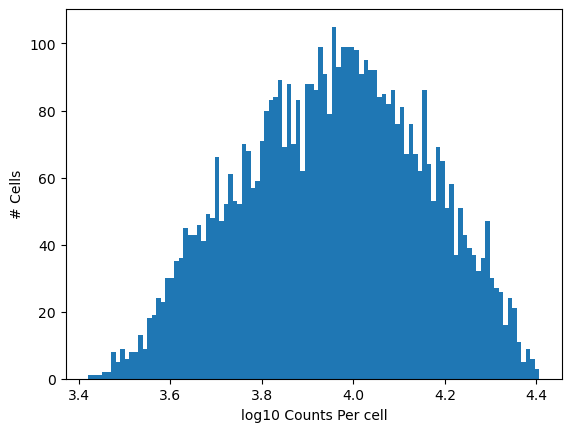

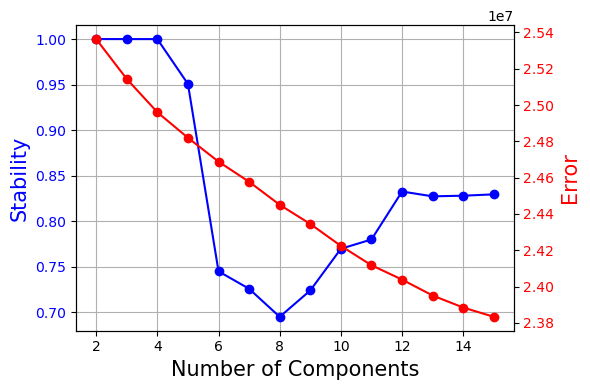

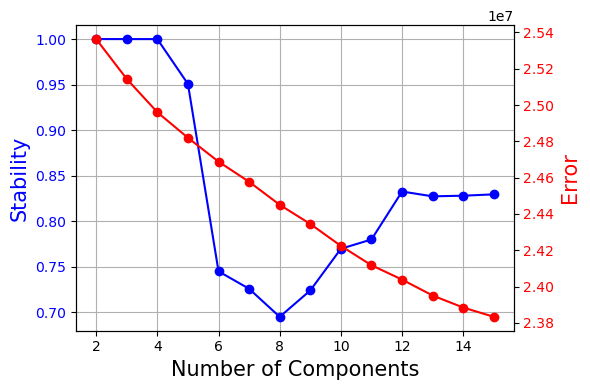

In [88]:
# Load in the naive data
cocl2 = sc.read_h5ad('cocl2.h5ad')
## plot log10 # counts per cell
plt.hist(np.log10(cocl2.obs['nCount_RNA']), bins=100)
_ = plt.xlabel('log10 Counts Per cell')
_ = plt.ylabel('# Cells')

if not os.path.exists('cocl2'):
    os.mkdir('cocl2')

cocl2.layers['counts'] = cocl2.raw.X.copy()
cocl2.layers['log1p'] = cocl2.X.copy()

count_adat_fn = 'cocl2/cocl2_counts.h5ad'
sc.write(count_adat_fn, cocl2)


cocl2_dense_data = pd.DataFrame(cocl2.layers['counts'].todense(), index=cocl2.obs.index, columns=cocl2.var.index).astype(int)
cocl2_dense_data.head()
count_txt_fn = 'cocl2/counts.tsv'
cocl2_dense_data.to_csv(count_txt_fn, sep='\t')

numiter=200 # Number of NMF replicates. Set this to a larger value ~200 for real data. We set this to a relatively low value here for illustration at a faster speed
numhvgenes=5000 ## Number of over-dispersed genes to use for running the actual factorizations

## Results will be saved to [output_directory]/[run_name] which in this example is example_PBMC/cNMF/pbmc_cNMF
output_directory = 'cocl2'
if not os.path.exists(output_directory):
    os.mkdir(output_directory)
run_name = 'cocl2_cNMF'

## Specify the Ks to use as a space separated list in this case "2 3 4 5 6 7 8 9 10"
K = ' '.join([str(i) for i in range(2,16)])

## To speed this up, you can run it for only K=7-8 with the option below
#K = ' '.join([str(i) for i in range(7,9)])


seed = 14 ## Specify a seed pseudorandom number generation for reproducibility

## Path to the filtered counts dataset we output previously
countfn = 'cocl2/cocl2_counts.h5ad'

## Initialize the cnmf object that will be used to run analyses
cocl2_cnmf_obj = cNMF(output_dir=output_directory, name=run_name)

## Prepare the data, I.e. subset to 5000 high-variance genes, and variance normalize
cocl2_cnmf_obj.prepare(counts_fn=count_txt_fn, components=np.arange(2,16), n_iter=200, seed=14, num_highvar_genes=5000)

## Specify that the jobs are being distributed over a single worker (total_workers=1) and then launch that worker
cocl2_cnmf_obj.factorize(worker_i=0, total_workers=1)

# Combine the individual factorizations
cocl2_cnmf_obj.combine()
# Compute the stability at each choice of K to see if a clear choice jumps out
cocl2_cnmf_obj.k_selection_plot(close_fig=False)

print('This saves the corresponding figure to the following file: %s' % cocl2_cnmf_obj.paths['k_selection_plot'])
# Combine the individual factorizations
cocl2_cnmf_obj.combine()

# Compute the stability at each choice of K to see if a clear choice jumps out
cocl2_cnmf_obj.k_selection_plot(close_fig=False)
print('This saves the corresponding figure to the following file: %s' % cocl2_cnmf_obj.paths['k_selection_plot'])

/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/cnmf/cnmf.py:835: RuntimeWarning: invalid value encountered in true_divide
  norm_tpm = (np.array(tpm.X.todense()) - tpm_stats['__mean'].values) / tpm_stats['__std'].values
/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


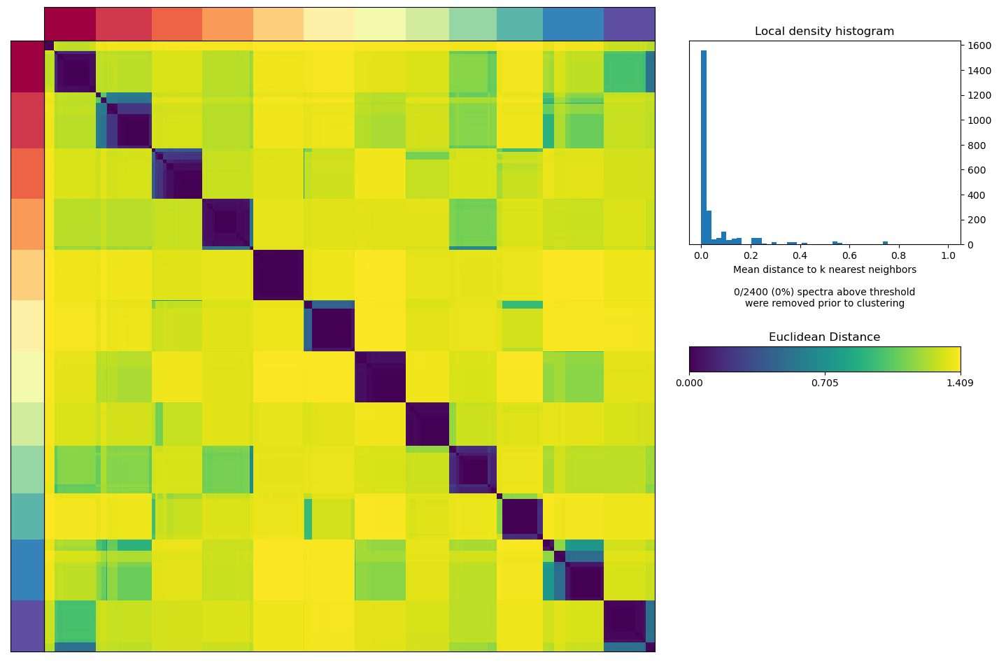

In [150]:
#find k with best stability
selected_K = 12
density_threshold = 2.00   
cocl2_cnmf_obj.consensus(k=selected_K, density_threshold=density_threshold, show_clustering=True, close_clustergram_fig=False)



/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/cnmf/cnmf.py:835: RuntimeWarning: invalid value encountered in true_divide
  norm_tpm = (np.array(tpm.X.todense()) - tpm_stats['__mean'].values) / tpm_stats['__std'].values
/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


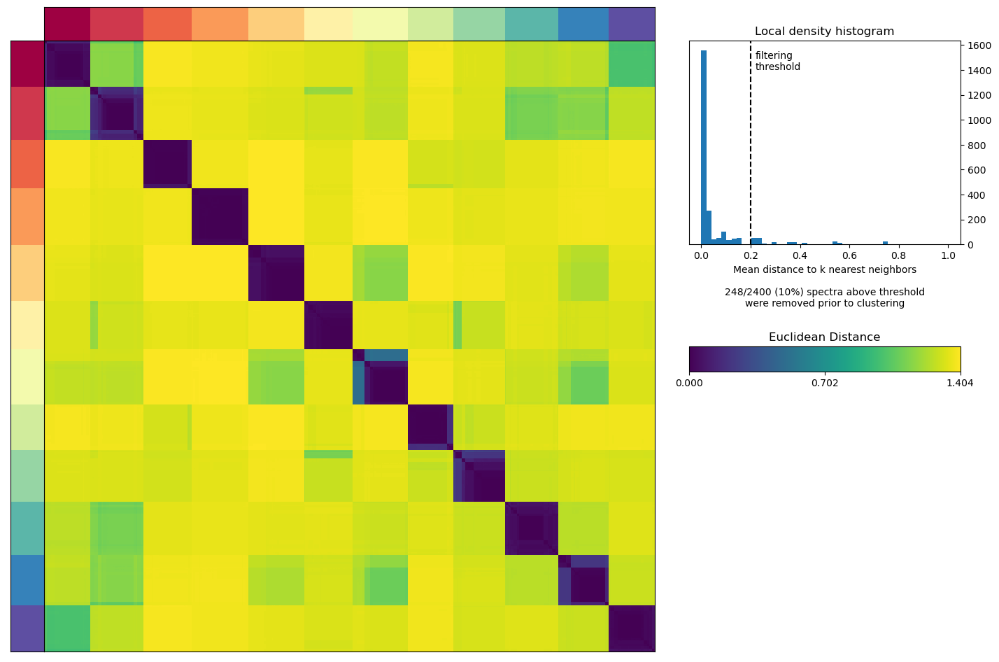

In [151]:
# Try increasingly stringent filters
density_threshold = 0.2
cocl2_cnmf_obj.consensus(k=selected_K, density_threshold=density_threshold, show_clustering=True, close_clustergram_fig=False)




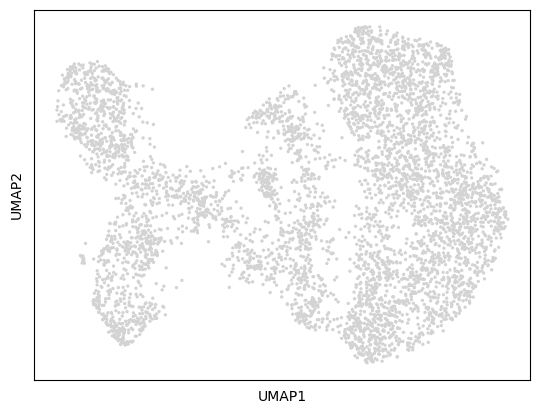

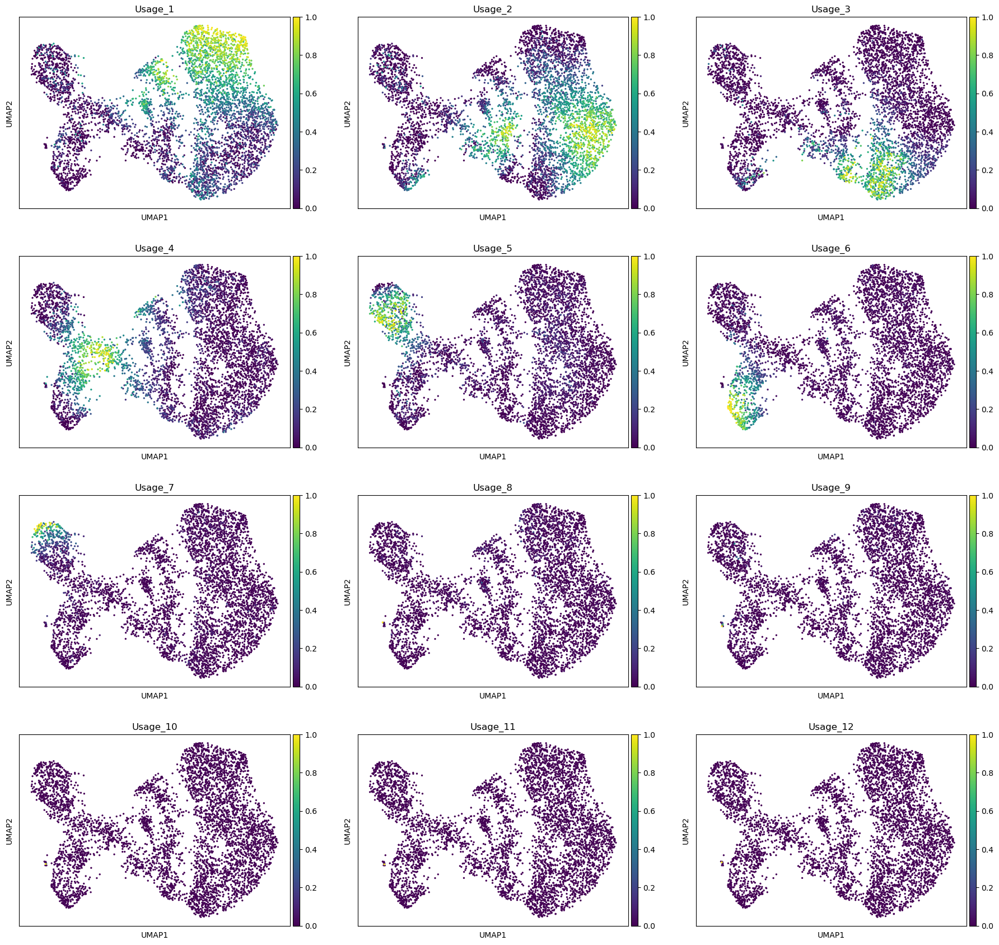

In [93]:
## Obtain high variance genes that were used for cNMF as these were saved to a text file
cocl2_hvgs = open('./cocl2/cocl2_cNMF/cocl2_cNMF.overdispersed_genes.txt').read().split('\n')
# Verify that the the naive umap is plotting correctly
sc.pl.umap(cocl2)
# We can load the results for a cNMF run with a given K and density filtering threshold like below
usage_norm, gep_scores, gep_tpm, topgenes = cocl2_cnmf_obj.load_results(K=selected_K, density_threshold=density_threshold)
usage_norm.columns = ['Usage%d' % i for i in usage_norm.columns]

gep_scores.to_csv('cocl2/cocl2_gep_scores.txt', sep='\t', index = True)

# Lets look at how the normalized usages segregate on the UMAP
cocl2.obs = pd.merge(left=cocl2.obs, right=usage_norm, how='left', left_index=True, right_index=True)

sc.pl.umap(cocl2, color=usage_norm.columns,
           use_raw=True, ncols=3, vmin=0, vmax=1)
top_genes = []
ngenes = 100
for gep in gep_scores.columns:
    top_genes.append(list(gep_scores.sort_values(by=gep, ascending=False).index[:ngenes]))
    
top_genes = pd.DataFrame(top_genes, index=gep_scores.columns).T
top_genes

topgenes.to_csv('cocl2/cocl2_topgenes.txt', sep='\t', index = False)


Acid

/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/anndata/compat/__init__.py:235: FutureWarning: Moving element from .uns['neighbors']['distances'] to .obsp['distances'].

This is where adjacency matrices should go now.
  FutureWarning,
/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/cnmf/cnmf.py:327: FutureWarning: X.dtype being converted to np.float32 from int64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  var=pd.DataFrame(index=input_counts.columns))
/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


[Worker 0]. Starting task 0.
[Worker 0]. Starting task 1.
[Worker 0]. Starting task 2.
[Worker 0]. Starting task 3.
[Worker 0]. Starting task 4.
[Worker 0]. Starting task 5.
[Worker 0]. Starting task 6.
[Worker 0]. Starting task 7.
[Worker 0]. Starting task 8.
[Worker 0]. Starting task 9.
[Worker 0]. Starting task 10.
[Worker 0]. Starting task 11.
[Worker 0]. Starting task 12.
[Worker 0]. Starting task 13.
[Worker 0]. Starting task 14.
[Worker 0]. Starting task 15.
[Worker 0]. Starting task 16.
[Worker 0]. Starting task 17.
[Worker 0]. Starting task 18.
[Worker 0]. Starting task 19.
[Worker 0]. Starting task 20.
[Worker 0]. Starting task 21.
[Worker 0]. Starting task 22.
[Worker 0]. Starting task 23.
[Worker 0]. Starting task 24.
[Worker 0]. Starting task 25.
[Worker 0]. Starting task 26.
[Worker 0]. Starting task 27.
[Worker 0]. Starting task 28.
[Worker 0]. Starting task 29.
[Worker 0]. Starting task 30.
[Worker 0]. Starting task 31.
[Worker 0]. Starting task 32.
[Worker 0]. Starting

/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 1609.
[Worker 0]. Starting task 1610.
[Worker 0]. Starting task 1611.
[Worker 0]. Starting task 1612.
[Worker 0]. Starting task 1613.
[Worker 0]. Starting task 1614.
[Worker 0]. Starting task 1615.
[Worker 0]. Starting task 1616.
[Worker 0]. Starting task 1617.


/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 1618.


/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 1619.
[Worker 0]. Starting task 1620.
[Worker 0]. Starting task 1621.
[Worker 0]. Starting task 1622.
[Worker 0]. Starting task 1623.
[Worker 0]. Starting task 1624.
[Worker 0]. Starting task 1625.
[Worker 0]. Starting task 1626.
[Worker 0]. Starting task 1627.
[Worker 0]. Starting task 1628.
[Worker 0]. Starting task 1629.
[Worker 0]. Starting task 1630.
[Worker 0]. Starting task 1631.


/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 1632.
[Worker 0]. Starting task 1633.
[Worker 0]. Starting task 1634.
[Worker 0]. Starting task 1635.
[Worker 0]. Starting task 1636.
[Worker 0]. Starting task 1637.
[Worker 0]. Starting task 1638.
[Worker 0]. Starting task 1639.
[Worker 0]. Starting task 1640.
[Worker 0]. Starting task 1641.
[Worker 0]. Starting task 1642.
[Worker 0]. Starting task 1643.
[Worker 0]. Starting task 1644.
[Worker 0]. Starting task 1645.
[Worker 0]. Starting task 1646.
[Worker 0]. Starting task 1647.
[Worker 0]. Starting task 1648.
[Worker 0]. Starting task 1649.
[Worker 0]. Starting task 1650.
[Worker 0]. Starting task 1651.
[Worker 0]. Starting task 1652.
[Worker 0]. Starting task 1653.
[Worker 0]. Starting task 1654.
[Worker 0]. Starting task 1655.
[Worker 0]. Starting task 1656.
[Worker 0]. Starting task 1657.


/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 1658.
[Worker 0]. Starting task 1659.
[Worker 0]. Starting task 1660.
[Worker 0]. Starting task 1661.
[Worker 0]. Starting task 1662.
[Worker 0]. Starting task 1663.
[Worker 0]. Starting task 1664.
[Worker 0]. Starting task 1665.
[Worker 0]. Starting task 1666.
[Worker 0]. Starting task 1667.
[Worker 0]. Starting task 1668.
[Worker 0]. Starting task 1669.
[Worker 0]. Starting task 1670.
[Worker 0]. Starting task 1671.
[Worker 0]. Starting task 1672.
[Worker 0]. Starting task 1673.


/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 1674.
[Worker 0]. Starting task 1675.
[Worker 0]. Starting task 1676.
[Worker 0]. Starting task 1677.
[Worker 0]. Starting task 1678.
[Worker 0]. Starting task 1679.
[Worker 0]. Starting task 1680.
[Worker 0]. Starting task 1681.


/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 1682.
[Worker 0]. Starting task 1683.
[Worker 0]. Starting task 1684.
[Worker 0]. Starting task 1685.
[Worker 0]. Starting task 1686.
[Worker 0]. Starting task 1687.


/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 1688.
[Worker 0]. Starting task 1689.
[Worker 0]. Starting task 1690.
[Worker 0]. Starting task 1691.
[Worker 0]. Starting task 1692.
[Worker 0]. Starting task 1693.
[Worker 0]. Starting task 1694.
[Worker 0]. Starting task 1695.
[Worker 0]. Starting task 1696.
[Worker 0]. Starting task 1697.
[Worker 0]. Starting task 1698.
[Worker 0]. Starting task 1699.


/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 1700.
[Worker 0]. Starting task 1701.
[Worker 0]. Starting task 1702.
[Worker 0]. Starting task 1703.
[Worker 0]. Starting task 1704.


/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 1705.
[Worker 0]. Starting task 1706.
[Worker 0]. Starting task 1707.
[Worker 0]. Starting task 1708.
[Worker 0]. Starting task 1709.
[Worker 0]. Starting task 1710.
[Worker 0]. Starting task 1711.
[Worker 0]. Starting task 1712.
[Worker 0]. Starting task 1713.
[Worker 0]. Starting task 1714.
[Worker 0]. Starting task 1715.
[Worker 0]. Starting task 1716.
[Worker 0]. Starting task 1717.
[Worker 0]. Starting task 1718.
[Worker 0]. Starting task 1719.
[Worker 0]. Starting task 1720.
[Worker 0]. Starting task 1721.
[Worker 0]. Starting task 1722.
[Worker 0]. Starting task 1723.
[Worker 0]. Starting task 1724.


/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 1725.
[Worker 0]. Starting task 1726.
[Worker 0]. Starting task 1727.
[Worker 0]. Starting task 1728.
[Worker 0]. Starting task 1729.
[Worker 0]. Starting task 1730.
[Worker 0]. Starting task 1731.
[Worker 0]. Starting task 1732.
[Worker 0]. Starting task 1733.
[Worker 0]. Starting task 1734.
[Worker 0]. Starting task 1735.
[Worker 0]. Starting task 1736.


/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 1737.
[Worker 0]. Starting task 1738.
[Worker 0]. Starting task 1739.
[Worker 0]. Starting task 1740.
[Worker 0]. Starting task 1741.
[Worker 0]. Starting task 1742.
[Worker 0]. Starting task 1743.
[Worker 0]. Starting task 1744.
[Worker 0]. Starting task 1745.
[Worker 0]. Starting task 1746.
[Worker 0]. Starting task 1747.
[Worker 0]. Starting task 1748.
[Worker 0]. Starting task 1749.
[Worker 0]. Starting task 1750.
[Worker 0]. Starting task 1751.
[Worker 0]. Starting task 1752.
[Worker 0]. Starting task 1753.
[Worker 0]. Starting task 1754.
[Worker 0]. Starting task 1755.
[Worker 0]. Starting task 1756.
[Worker 0]. Starting task 1757.
[Worker 0]. Starting task 1758.
[Worker 0]. Starting task 1759.
[Worker 0]. Starting task 1760.
[Worker 0]. Starting task 1761.
[Worker 0]. Starting task 1762.
[Worker 0]. Starting task 1763.
[Worker 0]. Starting task 1764.
[Worker 0]. Starting task 1765.
[Worker 0]. Starting task 1766.
[Worker 0]. Starting task 1767.
[Worker 

/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 1772.
[Worker 0]. Starting task 1773.
[Worker 0]. Starting task 1774.
[Worker 0]. Starting task 1775.
[Worker 0]. Starting task 1776.
[Worker 0]. Starting task 1777.
[Worker 0]. Starting task 1778.
[Worker 0]. Starting task 1779.
[Worker 0]. Starting task 1780.
[Worker 0]. Starting task 1781.


/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 1782.
[Worker 0]. Starting task 1783.
[Worker 0]. Starting task 1784.
[Worker 0]. Starting task 1785.
[Worker 0]. Starting task 1786.
[Worker 0]. Starting task 1787.
[Worker 0]. Starting task 1788.
[Worker 0]. Starting task 1789.
[Worker 0]. Starting task 1790.
[Worker 0]. Starting task 1791.
[Worker 0]. Starting task 1792.
[Worker 0]. Starting task 1793.
[Worker 0]. Starting task 1794.
[Worker 0]. Starting task 1795.
[Worker 0]. Starting task 1796.
[Worker 0]. Starting task 1797.
[Worker 0]. Starting task 1798.
[Worker 0]. Starting task 1799.
[Worker 0]. Starting task 1800.
[Worker 0]. Starting task 1801.
[Worker 0]. Starting task 1802.
[Worker 0]. Starting task 1803.
[Worker 0]. Starting task 1804.
[Worker 0]. Starting task 1805.
[Worker 0]. Starting task 1806.
[Worker 0]. Starting task 1807.
[Worker 0]. Starting task 1808.
[Worker 0]. Starting task 1809.
[Worker 0]. Starting task 1810.
[Worker 0]. Starting task 1811.
[Worker 0]. Starting task 1812.
[Worker 

/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 1952.
[Worker 0]. Starting task 1953.
[Worker 0]. Starting task 1954.
[Worker 0]. Starting task 1955.


/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 1956.
[Worker 0]. Starting task 1957.
[Worker 0]. Starting task 1958.
[Worker 0]. Starting task 1959.
[Worker 0]. Starting task 1960.
[Worker 0]. Starting task 1961.
[Worker 0]. Starting task 1962.
[Worker 0]. Starting task 1963.
[Worker 0]. Starting task 1964.
[Worker 0]. Starting task 1965.
[Worker 0]. Starting task 1966.
[Worker 0]. Starting task 1967.
[Worker 0]. Starting task 1968.
[Worker 0]. Starting task 1969.
[Worker 0]. Starting task 1970.
[Worker 0]. Starting task 1971.
[Worker 0]. Starting task 1972.
[Worker 0]. Starting task 1973.
[Worker 0]. Starting task 1974.
[Worker 0]. Starting task 1975.
[Worker 0]. Starting task 1976.
[Worker 0]. Starting task 1977.
[Worker 0]. Starting task 1978.
[Worker 0]. Starting task 1979.
[Worker 0]. Starting task 1980.
[Worker 0]. Starting task 1981.
[Worker 0]. Starting task 1982.
[Worker 0]. Starting task 1983.
[Worker 0]. Starting task 1984.
[Worker 0]. Starting task 1985.
[Worker 0]. Starting task 1986.
[Worker 

/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 2012.
[Worker 0]. Starting task 2013.
[Worker 0]. Starting task 2014.


/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 2015.
[Worker 0]. Starting task 2016.
[Worker 0]. Starting task 2017.
[Worker 0]. Starting task 2018.
[Worker 0]. Starting task 2019.
[Worker 0]. Starting task 2020.
[Worker 0]. Starting task 2021.
[Worker 0]. Starting task 2022.
[Worker 0]. Starting task 2023.
[Worker 0]. Starting task 2024.
[Worker 0]. Starting task 2025.
[Worker 0]. Starting task 2026.
[Worker 0]. Starting task 2027.
[Worker 0]. Starting task 2028.
[Worker 0]. Starting task 2029.
[Worker 0]. Starting task 2030.
[Worker 0]. Starting task 2031.
[Worker 0]. Starting task 2032.
[Worker 0]. Starting task 2033.
[Worker 0]. Starting task 2034.
[Worker 0]. Starting task 2035.
[Worker 0]. Starting task 2036.
[Worker 0]. Starting task 2037.
[Worker 0]. Starting task 2038.
[Worker 0]. Starting task 2039.
[Worker 0]. Starting task 2040.
[Worker 0]. Starting task 2041.
[Worker 0]. Starting task 2042.
[Worker 0]. Starting task 2043.
[Worker 0]. Starting task 2044.
[Worker 0]. Starting task 2045.
[Worker 

/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 2079.
[Worker 0]. Starting task 2080.
[Worker 0]. Starting task 2081.
[Worker 0]. Starting task 2082.
[Worker 0]. Starting task 2083.
[Worker 0]. Starting task 2084.
[Worker 0]. Starting task 2085.
[Worker 0]. Starting task 2086.
[Worker 0]. Starting task 2087.
[Worker 0]. Starting task 2088.
[Worker 0]. Starting task 2089.
[Worker 0]. Starting task 2090.
[Worker 0]. Starting task 2091.
[Worker 0]. Starting task 2092.
[Worker 0]. Starting task 2093.
[Worker 0]. Starting task 2094.
[Worker 0]. Starting task 2095.
[Worker 0]. Starting task 2096.
[Worker 0]. Starting task 2097.
[Worker 0]. Starting task 2098.
[Worker 0]. Starting task 2099.
[Worker 0]. Starting task 2100.
[Worker 0]. Starting task 2101.
[Worker 0]. Starting task 2102.
[Worker 0]. Starting task 2103.
[Worker 0]. Starting task 2104.
[Worker 0]. Starting task 2105.
[Worker 0]. Starting task 2106.
[Worker 0]. Starting task 2107.
[Worker 0]. Starting task 2108.
[Worker 0]. Starting task 2109.
[Worker 

/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 2125.
[Worker 0]. Starting task 2126.
[Worker 0]. Starting task 2127.
[Worker 0]. Starting task 2128.
[Worker 0]. Starting task 2129.
[Worker 0]. Starting task 2130.
[Worker 0]. Starting task 2131.
[Worker 0]. Starting task 2132.
[Worker 0]. Starting task 2133.
[Worker 0]. Starting task 2134.
[Worker 0]. Starting task 2135.
[Worker 0]. Starting task 2136.


/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 2137.
[Worker 0]. Starting task 2138.
[Worker 0]. Starting task 2139.
[Worker 0]. Starting task 2140.
[Worker 0]. Starting task 2141.
[Worker 0]. Starting task 2142.
[Worker 0]. Starting task 2143.
[Worker 0]. Starting task 2144.
[Worker 0]. Starting task 2145.
[Worker 0]. Starting task 2146.
[Worker 0]. Starting task 2147.
[Worker 0]. Starting task 2148.
[Worker 0]. Starting task 2149.
[Worker 0]. Starting task 2150.
[Worker 0]. Starting task 2151.
[Worker 0]. Starting task 2152.
[Worker 0]. Starting task 2153.
[Worker 0]. Starting task 2154.
[Worker 0]. Starting task 2155.
[Worker 0]. Starting task 2156.
[Worker 0]. Starting task 2157.
[Worker 0]. Starting task 2158.
[Worker 0]. Starting task 2159.
[Worker 0]. Starting task 2160.
[Worker 0]. Starting task 2161.
[Worker 0]. Starting task 2162.
[Worker 0]. Starting task 2163.
[Worker 0]. Starting task 2164.
[Worker 0]. Starting task 2165.
[Worker 0]. Starting task 2166.
[Worker 0]. Starting task 2167.
[Worker 

/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 2178.
[Worker 0]. Starting task 2179.
[Worker 0]. Starting task 2180.
[Worker 0]. Starting task 2181.
[Worker 0]. Starting task 2182.
[Worker 0]. Starting task 2183.
[Worker 0]. Starting task 2184.
[Worker 0]. Starting task 2185.
[Worker 0]. Starting task 2186.
[Worker 0]. Starting task 2187.
[Worker 0]. Starting task 2188.
[Worker 0]. Starting task 2189.
[Worker 0]. Starting task 2190.
[Worker 0]. Starting task 2191.
[Worker 0]. Starting task 2192.
[Worker 0]. Starting task 2193.
[Worker 0]. Starting task 2194.


/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 2195.
[Worker 0]. Starting task 2196.
[Worker 0]. Starting task 2197.
[Worker 0]. Starting task 2198.
[Worker 0]. Starting task 2199.
[Worker 0]. Starting task 2200.
[Worker 0]. Starting task 2201.
[Worker 0]. Starting task 2202.
[Worker 0]. Starting task 2203.
[Worker 0]. Starting task 2204.
[Worker 0]. Starting task 2205.
[Worker 0]. Starting task 2206.
[Worker 0]. Starting task 2207.
[Worker 0]. Starting task 2208.
[Worker 0]. Starting task 2209.
[Worker 0]. Starting task 2210.


/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 2211.
[Worker 0]. Starting task 2212.
[Worker 0]. Starting task 2213.


/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 2214.
[Worker 0]. Starting task 2215.
[Worker 0]. Starting task 2216.
[Worker 0]. Starting task 2217.
[Worker 0]. Starting task 2218.
[Worker 0]. Starting task 2219.
[Worker 0]. Starting task 2220.
[Worker 0]. Starting task 2221.
[Worker 0]. Starting task 2222.
[Worker 0]. Starting task 2223.
[Worker 0]. Starting task 2224.
[Worker 0]. Starting task 2225.
[Worker 0]. Starting task 2226.
[Worker 0]. Starting task 2227.
[Worker 0]. Starting task 2228.
[Worker 0]. Starting task 2229.
[Worker 0]. Starting task 2230.
[Worker 0]. Starting task 2231.
[Worker 0]. Starting task 2232.
[Worker 0]. Starting task 2233.
[Worker 0]. Starting task 2234.
[Worker 0]. Starting task 2235.
[Worker 0]. Starting task 2236.
[Worker 0]. Starting task 2237.
[Worker 0]. Starting task 2238.
[Worker 0]. Starting task 2239.
[Worker 0]. Starting task 2240.
[Worker 0]. Starting task 2241.
[Worker 0]. Starting task 2242.
[Worker 0]. Starting task 2243.
[Worker 0]. Starting task 2244.
[Worker 

/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 2353.
[Worker 0]. Starting task 2354.
[Worker 0]. Starting task 2355.
[Worker 0]. Starting task 2356.
[Worker 0]. Starting task 2357.
[Worker 0]. Starting task 2358.
[Worker 0]. Starting task 2359.
[Worker 0]. Starting task 2360.
[Worker 0]. Starting task 2361.
[Worker 0]. Starting task 2362.
[Worker 0]. Starting task 2363.
[Worker 0]. Starting task 2364.
[Worker 0]. Starting task 2365.
[Worker 0]. Starting task 2366.
[Worker 0]. Starting task 2367.
[Worker 0]. Starting task 2368.
[Worker 0]. Starting task 2369.
[Worker 0]. Starting task 2370.
[Worker 0]. Starting task 2371.
[Worker 0]. Starting task 2372.
[Worker 0]. Starting task 2373.
[Worker 0]. Starting task 2374.
[Worker 0]. Starting task 2375.
[Worker 0]. Starting task 2376.
[Worker 0]. Starting task 2377.
[Worker 0]. Starting task 2378.
[Worker 0]. Starting task 2379.
[Worker 0]. Starting task 2380.
[Worker 0]. Starting task 2381.
[Worker 0]. Starting task 2382.
[Worker 0]. Starting task 2383.
[Worker 

/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 2404.
[Worker 0]. Starting task 2405.
[Worker 0]. Starting task 2406.
[Worker 0]. Starting task 2407.
[Worker 0]. Starting task 2408.
[Worker 0]. Starting task 2409.
[Worker 0]. Starting task 2410.
[Worker 0]. Starting task 2411.
[Worker 0]. Starting task 2412.
[Worker 0]. Starting task 2413.
[Worker 0]. Starting task 2414.
[Worker 0]. Starting task 2415.
[Worker 0]. Starting task 2416.
[Worker 0]. Starting task 2417.
[Worker 0]. Starting task 2418.
[Worker 0]. Starting task 2419.
[Worker 0]. Starting task 2420.
[Worker 0]. Starting task 2421.
[Worker 0]. Starting task 2422.
[Worker 0]. Starting task 2423.
[Worker 0]. Starting task 2424.
[Worker 0]. Starting task 2425.
[Worker 0]. Starting task 2426.
[Worker 0]. Starting task 2427.
[Worker 0]. Starting task 2428.
[Worker 0]. Starting task 2429.
[Worker 0]. Starting task 2430.
[Worker 0]. Starting task 2431.
[Worker 0]. Starting task 2432.
[Worker 0]. Starting task 2433.
[Worker 0]. Starting task 2434.
[Worker 

/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 2450.
[Worker 0]. Starting task 2451.
[Worker 0]. Starting task 2452.
[Worker 0]. Starting task 2453.
[Worker 0]. Starting task 2454.
[Worker 0]. Starting task 2455.
[Worker 0]. Starting task 2456.
[Worker 0]. Starting task 2457.
[Worker 0]. Starting task 2458.
[Worker 0]. Starting task 2459.
[Worker 0]. Starting task 2460.
[Worker 0]. Starting task 2461.
[Worker 0]. Starting task 2462.
[Worker 0]. Starting task 2463.
[Worker 0]. Starting task 2464.
[Worker 0]. Starting task 2465.
[Worker 0]. Starting task 2466.
[Worker 0]. Starting task 2467.
[Worker 0]. Starting task 2468.
[Worker 0]. Starting task 2469.
[Worker 0]. Starting task 2470.
[Worker 0]. Starting task 2471.
[Worker 0]. Starting task 2472.
[Worker 0]. Starting task 2473.
[Worker 0]. Starting task 2474.
[Worker 0]. Starting task 2475.
[Worker 0]. Starting task 2476.
[Worker 0]. Starting task 2477.
[Worker 0]. Starting task 2478.
[Worker 0]. Starting task 2479.
[Worker 0]. Starting task 2480.
[Worker 

/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 2510.
[Worker 0]. Starting task 2511.
[Worker 0]. Starting task 2512.
[Worker 0]. Starting task 2513.
[Worker 0]. Starting task 2514.
[Worker 0]. Starting task 2515.
[Worker 0]. Starting task 2516.
[Worker 0]. Starting task 2517.
[Worker 0]. Starting task 2518.
[Worker 0]. Starting task 2519.
[Worker 0]. Starting task 2520.
[Worker 0]. Starting task 2521.
[Worker 0]. Starting task 2522.
[Worker 0]. Starting task 2523.
[Worker 0]. Starting task 2524.
[Worker 0]. Starting task 2525.
[Worker 0]. Starting task 2526.
[Worker 0]. Starting task 2527.
[Worker 0]. Starting task 2528.
[Worker 0]. Starting task 2529.
[Worker 0]. Starting task 2530.
[Worker 0]. Starting task 2531.
[Worker 0]. Starting task 2532.
[Worker 0]. Starting task 2533.
[Worker 0]. Starting task 2534.
[Worker 0]. Starting task 2535.
[Worker 0]. Starting task 2536.
[Worker 0]. Starting task 2537.
[Worker 0]. Starting task 2538.
[Worker 0]. Starting task 2539.
[Worker 0]. Starting task 2540.
[Worker 

/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 2589.
[Worker 0]. Starting task 2590.
[Worker 0]. Starting task 2591.
[Worker 0]. Starting task 2592.
[Worker 0]. Starting task 2593.
[Worker 0]. Starting task 2594.
[Worker 0]. Starting task 2595.
[Worker 0]. Starting task 2596.
[Worker 0]. Starting task 2597.
[Worker 0]. Starting task 2598.
[Worker 0]. Starting task 2599.
[Worker 0]. Starting task 2600.
[Worker 0]. Starting task 2601.
[Worker 0]. Starting task 2602.
[Worker 0]. Starting task 2603.
[Worker 0]. Starting task 2604.
[Worker 0]. Starting task 2605.
[Worker 0]. Starting task 2606.
[Worker 0]. Starting task 2607.
[Worker 0]. Starting task 2608.
[Worker 0]. Starting task 2609.
[Worker 0]. Starting task 2610.
[Worker 0]. Starting task 2611.
[Worker 0]. Starting task 2612.


/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 2613.
[Worker 0]. Starting task 2614.
[Worker 0]. Starting task 2615.
[Worker 0]. Starting task 2616.
[Worker 0]. Starting task 2617.
[Worker 0]. Starting task 2618.


/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 2619.


/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 2620.


/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 2621.
[Worker 0]. Starting task 2622.
[Worker 0]. Starting task 2623.
[Worker 0]. Starting task 2624.
[Worker 0]. Starting task 2625.
[Worker 0]. Starting task 2626.
[Worker 0]. Starting task 2627.


/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 2628.
[Worker 0]. Starting task 2629.
[Worker 0]. Starting task 2630.
[Worker 0]. Starting task 2631.
[Worker 0]. Starting task 2632.
[Worker 0]. Starting task 2633.
[Worker 0]. Starting task 2634.
[Worker 0]. Starting task 2635.
[Worker 0]. Starting task 2636.
[Worker 0]. Starting task 2637.
[Worker 0]. Starting task 2638.
[Worker 0]. Starting task 2639.
[Worker 0]. Starting task 2640.
[Worker 0]. Starting task 2641.
[Worker 0]. Starting task 2642.
[Worker 0]. Starting task 2643.
[Worker 0]. Starting task 2644.
[Worker 0]. Starting task 2645.
[Worker 0]. Starting task 2646.
[Worker 0]. Starting task 2647.
[Worker 0]. Starting task 2648.
[Worker 0]. Starting task 2649.
[Worker 0]. Starting task 2650.
[Worker 0]. Starting task 2651.
[Worker 0]. Starting task 2652.
[Worker 0]. Starting task 2653.
[Worker 0]. Starting task 2654.
[Worker 0]. Starting task 2655.


/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 2656.
[Worker 0]. Starting task 2657.
[Worker 0]. Starting task 2658.
[Worker 0]. Starting task 2659.
[Worker 0]. Starting task 2660.
[Worker 0]. Starting task 2661.
[Worker 0]. Starting task 2662.
[Worker 0]. Starting task 2663.
[Worker 0]. Starting task 2664.
[Worker 0]. Starting task 2665.
[Worker 0]. Starting task 2666.
[Worker 0]. Starting task 2667.
[Worker 0]. Starting task 2668.
[Worker 0]. Starting task 2669.
[Worker 0]. Starting task 2670.
[Worker 0]. Starting task 2671.
[Worker 0]. Starting task 2672.
[Worker 0]. Starting task 2673.
[Worker 0]. Starting task 2674.
[Worker 0]. Starting task 2675.
[Worker 0]. Starting task 2676.
[Worker 0]. Starting task 2677.
[Worker 0]. Starting task 2678.
[Worker 0]. Starting task 2679.
[Worker 0]. Starting task 2680.
[Worker 0]. Starting task 2681.
[Worker 0]. Starting task 2682.
[Worker 0]. Starting task 2683.
[Worker 0]. Starting task 2684.
[Worker 0]. Starting task 2685.
[Worker 0]. Starting task 2686.
[Worker 

/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 2689.
[Worker 0]. Starting task 2690.
[Worker 0]. Starting task 2691.
[Worker 0]. Starting task 2692.
[Worker 0]. Starting task 2693.
[Worker 0]. Starting task 2694.
[Worker 0]. Starting task 2695.
[Worker 0]. Starting task 2696.
[Worker 0]. Starting task 2697.
[Worker 0]. Starting task 2698.
[Worker 0]. Starting task 2699.
[Worker 0]. Starting task 2700.
[Worker 0]. Starting task 2701.
[Worker 0]. Starting task 2702.
[Worker 0]. Starting task 2703.
[Worker 0]. Starting task 2704.
[Worker 0]. Starting task 2705.
[Worker 0]. Starting task 2706.
[Worker 0]. Starting task 2707.
[Worker 0]. Starting task 2708.
[Worker 0]. Starting task 2709.
[Worker 0]. Starting task 2710.
[Worker 0]. Starting task 2711.
[Worker 0]. Starting task 2712.
[Worker 0]. Starting task 2713.
[Worker 0]. Starting task 2714.
[Worker 0]. Starting task 2715.
[Worker 0]. Starting task 2716.
[Worker 0]. Starting task 2717.
[Worker 0]. Starting task 2718.
[Worker 0]. Starting task 2719.
[Worker 

/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 2724.
[Worker 0]. Starting task 2725.
[Worker 0]. Starting task 2726.
[Worker 0]. Starting task 2727.
[Worker 0]. Starting task 2728.
[Worker 0]. Starting task 2729.
[Worker 0]. Starting task 2730.
[Worker 0]. Starting task 2731.
[Worker 0]. Starting task 2732.
[Worker 0]. Starting task 2733.
[Worker 0]. Starting task 2734.
[Worker 0]. Starting task 2735.
[Worker 0]. Starting task 2736.
[Worker 0]. Starting task 2737.
[Worker 0]. Starting task 2738.
[Worker 0]. Starting task 2739.
[Worker 0]. Starting task 2740.
[Worker 0]. Starting task 2741.
[Worker 0]. Starting task 2742.
[Worker 0]. Starting task 2743.
[Worker 0]. Starting task 2744.
[Worker 0]. Starting task 2745.
[Worker 0]. Starting task 2746.
[Worker 0]. Starting task 2747.
[Worker 0]. Starting task 2748.
[Worker 0]. Starting task 2749.
[Worker 0]. Starting task 2750.
[Worker 0]. Starting task 2751.
[Worker 0]. Starting task 2752.


/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 2753.
[Worker 0]. Starting task 2754.
[Worker 0]. Starting task 2755.
[Worker 0]. Starting task 2756.
[Worker 0]. Starting task 2757.
[Worker 0]. Starting task 2758.


/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 2759.
[Worker 0]. Starting task 2760.
[Worker 0]. Starting task 2761.
[Worker 0]. Starting task 2762.
[Worker 0]. Starting task 2763.
[Worker 0]. Starting task 2764.
[Worker 0]. Starting task 2765.
[Worker 0]. Starting task 2766.
[Worker 0]. Starting task 2767.
[Worker 0]. Starting task 2768.
[Worker 0]. Starting task 2769.
[Worker 0]. Starting task 2770.
[Worker 0]. Starting task 2771.
[Worker 0]. Starting task 2772.
[Worker 0]. Starting task 2773.
[Worker 0]. Starting task 2774.
[Worker 0]. Starting task 2775.
[Worker 0]. Starting task 2776.


/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 2777.
[Worker 0]. Starting task 2778.
[Worker 0]. Starting task 2779.
[Worker 0]. Starting task 2780.
[Worker 0]. Starting task 2781.
[Worker 0]. Starting task 2782.
[Worker 0]. Starting task 2783.
[Worker 0]. Starting task 2784.
[Worker 0]. Starting task 2785.
[Worker 0]. Starting task 2786.


/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 2787.


/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 2788.
[Worker 0]. Starting task 2789.
[Worker 0]. Starting task 2790.
[Worker 0]. Starting task 2791.
[Worker 0]. Starting task 2792.
[Worker 0]. Starting task 2793.
[Worker 0]. Starting task 2794.


/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 2795.
[Worker 0]. Starting task 2796.
[Worker 0]. Starting task 2797.
[Worker 0]. Starting task 2798.
[Worker 0]. Starting task 2799.
Combining factorizations for k=2.
Combining factorizations for k=3.
Combining factorizations for k=4.
Combining factorizations for k=5.
Combining factorizations for k=6.
Combining factorizations for k=7.
Combining factorizations for k=8.
Combining factorizations for k=9.
Combining factorizations for k=10.
Combining factorizations for k=11.
Combining factorizations for k=12.
Combining factorizations for k=13.
Combining factorizations for k=14.
Combining factorizations for k=15.
This saves the corresponding figure to the following file: acid/acid_cNMF/acid_cNMF.k_selection.png
Combining factorizations for k=2.
Combining factorizations for k=3.
Combining factorizations for k=4.
Combining factorizations for k=5.
Combining factorizations for k=6.
Combining factorizations for k=7.
Combining factorizations for k=8.
Combining factorizat

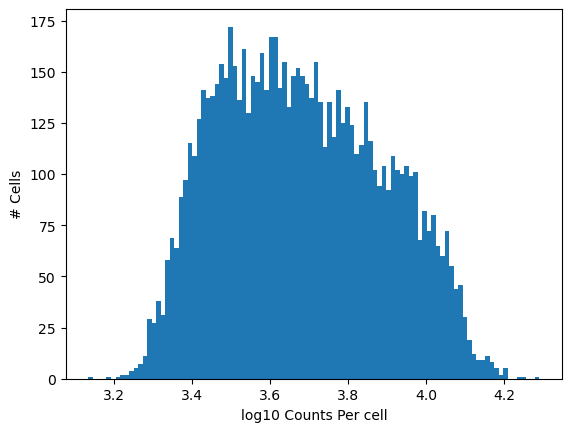

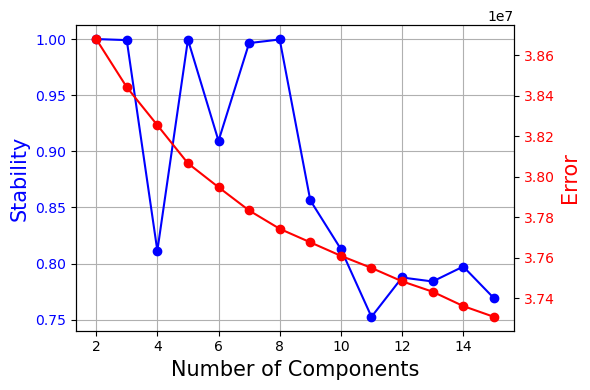

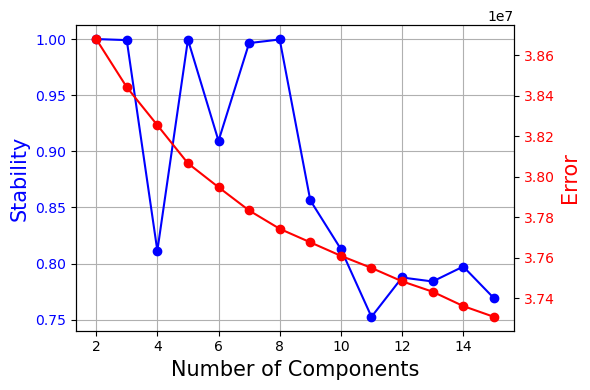

In [120]:
# Load in the naive data
acid = sc.read_h5ad('acid.h5ad')
## plot log10 # counts per cell
plt.hist(np.log10(acid.obs['nCount_RNA']), bins=100)
_ = plt.xlabel('log10 Counts Per cell')
_ = plt.ylabel('# Cells')

if not os.path.exists('acid'):
    os.mkdir('acid')

acid.layers['counts'] = acid.raw.X.copy()
acid.layers['log1p'] = acid.X.copy()

count_adat_fn = 'acid/acid_counts.h5ad'
sc.write(count_adat_fn, acid)


acid_dense_data = pd.DataFrame(acid.layers['counts'].todense(), index=acid.obs.index, columns=acid.var.index).astype(int)
acid_dense_data.head()
count_txt_fn = 'acid/counts.tsv'
acid_dense_data.to_csv(count_txt_fn, sep='\t')

numiter=200 # Number of NMF replicates. Set this to a larger value ~200 for real data. We set this to a relatively low value here for illustration at a faster speed
numhvgenes=5000 ## Number of over-dispersed genes to use for running the actual factorizations

## Results will be saved to [output_directory]/[run_name] which in this example is example_PBMC/cNMF/pbmc_cNMF
output_directory = 'acid'
if not os.path.exists(output_directory):
    os.mkdir(output_directory)
run_name = 'acid_cNMF'

## Specify the Ks to use as a space separated list in this case "2 3 4 5 6 7 8 9 10"
K = ' '.join([str(i) for i in range(2,16)])

## To speed this up, you can run it for only K=7-8 with the option below
#K = ' '.join([str(i) for i in range(7,9)])


seed = 14 ## Specify a seed pseudorandom number generation for reproducibility

## Path to the filtered counts dataset we output previously
countfn = 'acid/acid_counts.h5ad'

## Initialize the cnmf object that will be used to run analyses
acid_cnmf_obj = cNMF(output_dir=output_directory, name=run_name)

## Prepare the data, I.e. subset to 5000 high-variance genes, and variance normalize
acid_cnmf_obj.prepare(counts_fn=count_txt_fn, components=np.arange(2,16), n_iter=200, seed=14, num_highvar_genes=5000)

## Specify that the jobs are being distributed over a single worker (total_workers=1) and then launch that worker
acid_cnmf_obj.factorize(worker_i=0, total_workers=1)

# Combine the individual factorizations
acid_cnmf_obj.combine()
# Compute the stability at each choice of K to see if a clear choice jumps out
acid_cnmf_obj.k_selection_plot(close_fig=False)

print('This saves the corresponding figure to the following file: %s' % acid_cnmf_obj.paths['k_selection_plot'])
# Combine the individual factorizations
acid_cnmf_obj.combine()

# Compute the stability at each choice of K to see if a clear choice jumps out
acid_cnmf_obj.k_selection_plot(close_fig=False)
print('This saves the corresponding figure to the following file: %s' % acid_cnmf_obj.paths['k_selection_plot'])

/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/cnmf/cnmf.py:835: RuntimeWarning: invalid value encountered in true_divide
  norm_tpm = (np.array(tpm.X.todense()) - tpm_stats['__mean'].values) / tpm_stats['__std'].values
/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


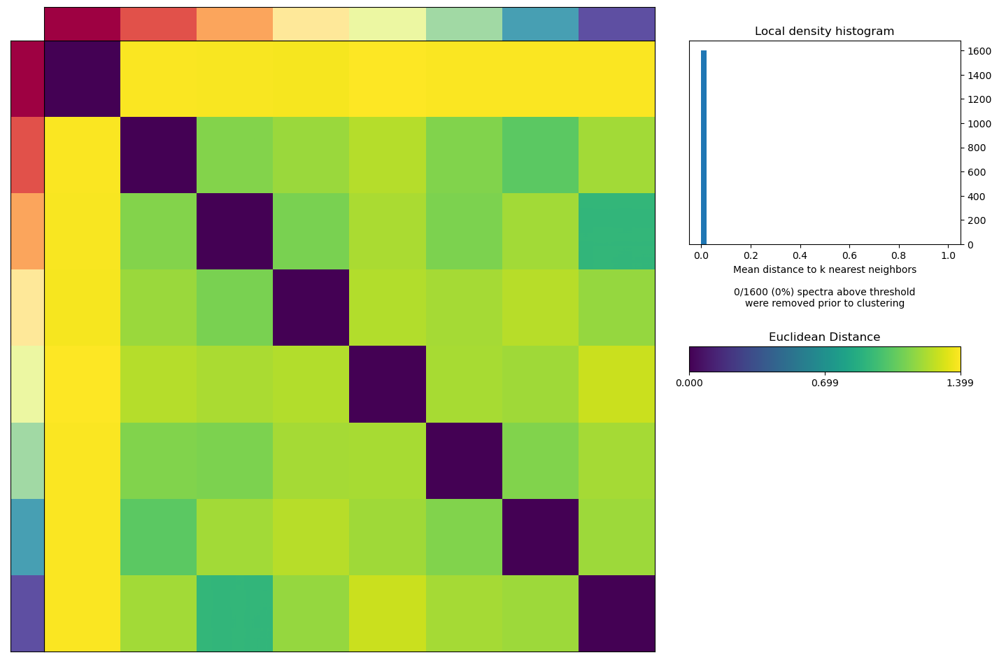

In [153]:
#find k with best stability
selected_K = 8
density_threshold = 2.00   
acid_cnmf_obj.consensus(k=selected_K, density_threshold=density_threshold, show_clustering=True, close_clustergram_fig=False)




/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/cnmf/cnmf.py:835: RuntimeWarning: invalid value encountered in true_divide
  norm_tpm = (np.array(tpm.X.todense()) - tpm_stats['__mean'].values) / tpm_stats['__std'].values
/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


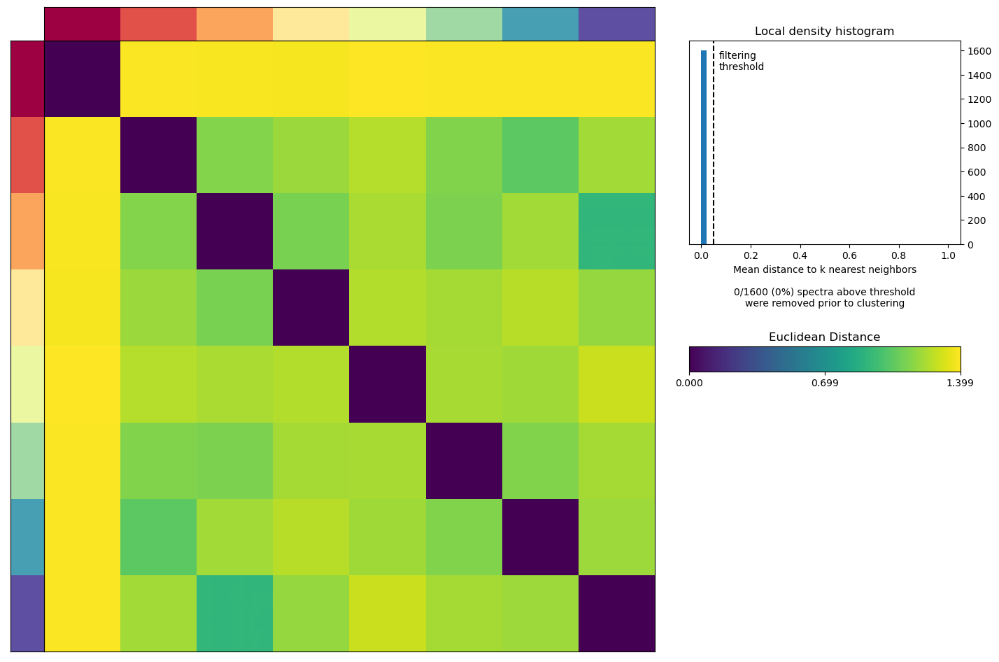

In [154]:
# Try increasingly stringent filters
density_threshold = 0.05
acid_cnmf_obj.consensus(k=selected_K, density_threshold=density_threshold, show_clustering=True, close_clustergram_fig=False)





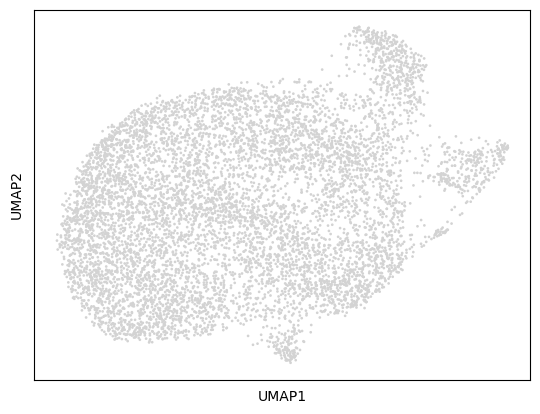

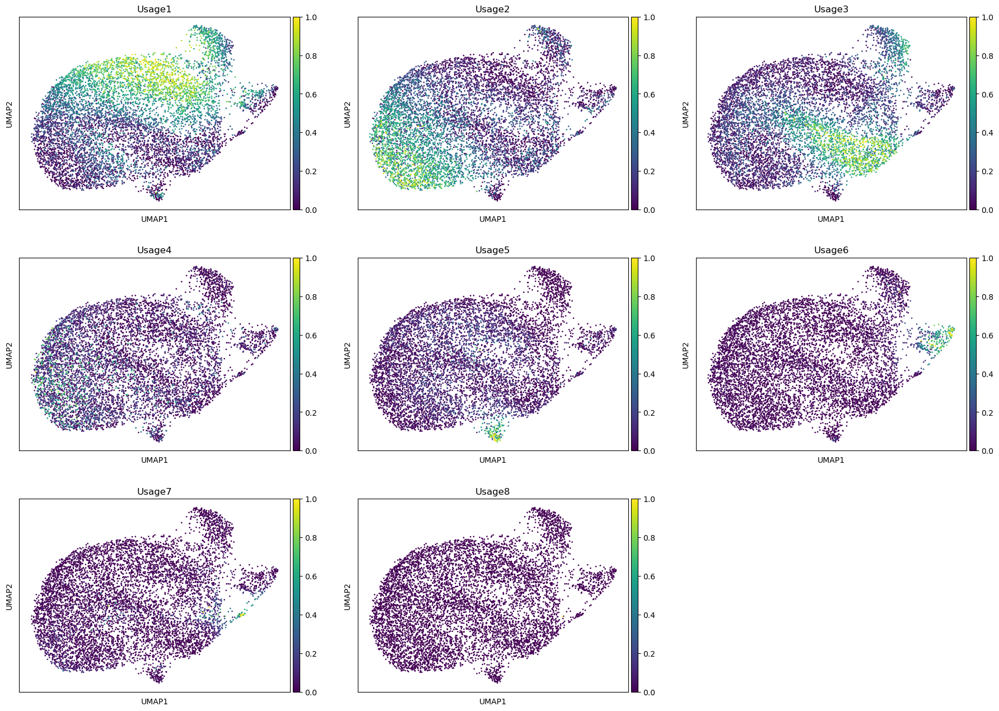

In [155]:
## Obtain high variance genes that were used for cNMF as these were saved to a text file
acid_hvgs = open('./acid/acid_cNMF/acid_cNMF.overdispersed_genes.txt').read().split('\n')
# Verify that the the naive umap is plotting correctly
sc.pl.umap(acid)
# We can load the results for a cNMF run with a given K and density filtering threshold like below
usage_norm, gep_scores, gep_tpm, topgenes = acid_cnmf_obj.load_results(K=selected_K, density_threshold=density_threshold)
usage_norm.columns = ['Usage%d' % i for i in usage_norm.columns]

gep_scores.to_csv('acid/acid_gep_scores.txt', sep='\t', index = True)

# Lets look at how the normalized usages segregate on the UMAP
acid.obs = pd.merge(left=acid.obs, right=usage_norm, how='left', left_index=True, right_index=True)

sc.pl.umap(acid, color=usage_norm.columns,
           use_raw=True, ncols=3, vmin=0, vmax=1)
top_genes = []
ngenes = 100
for gep in gep_scores.columns:
    top_genes.append(list(gep_scores.sort_values(by=gep, ascending=False).index[:ngenes]))
    
top_genes = pd.DataFrame(top_genes, index=gep_scores.columns).T
top_genes

topgenes.to_csv('acid/acid_topgenes.txt', sep='\t', index = False)

Cisplatin

/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/anndata/compat/__init__.py:235: FutureWarning: Moving element from .uns['neighbors']['distances'] to .obsp['distances'].

This is where adjacency matrices should go now.
  FutureWarning,
/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/cnmf/cnmf.py:327: FutureWarning: X.dtype being converted to np.float32 from int64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  var=pd.DataFrame(index=input_counts.columns))
/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


[Worker 0]. Starting task 0.
[Worker 0]. Starting task 1.
[Worker 0]. Starting task 2.
[Worker 0]. Starting task 3.
[Worker 0]. Starting task 4.
[Worker 0]. Starting task 5.
[Worker 0]. Starting task 6.
[Worker 0]. Starting task 7.
[Worker 0]. Starting task 8.
[Worker 0]. Starting task 9.
[Worker 0]. Starting task 10.
[Worker 0]. Starting task 11.
[Worker 0]. Starting task 12.
[Worker 0]. Starting task 13.
[Worker 0]. Starting task 14.
[Worker 0]. Starting task 15.
[Worker 0]. Starting task 16.
[Worker 0]. Starting task 17.
[Worker 0]. Starting task 18.
[Worker 0]. Starting task 19.
[Worker 0]. Starting task 20.
[Worker 0]. Starting task 21.
[Worker 0]. Starting task 22.
[Worker 0]. Starting task 23.
[Worker 0]. Starting task 24.
[Worker 0]. Starting task 25.
[Worker 0]. Starting task 26.
[Worker 0]. Starting task 27.
[Worker 0]. Starting task 28.
[Worker 0]. Starting task 29.
[Worker 0]. Starting task 30.
[Worker 0]. Starting task 31.
[Worker 0]. Starting task 32.
[Worker 0]. Starting

/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 2405.
[Worker 0]. Starting task 2406.
[Worker 0]. Starting task 2407.
[Worker 0]. Starting task 2408.
[Worker 0]. Starting task 2409.
[Worker 0]. Starting task 2410.
[Worker 0]. Starting task 2411.
[Worker 0]. Starting task 2412.
[Worker 0]. Starting task 2413.
[Worker 0]. Starting task 2414.
[Worker 0]. Starting task 2415.
[Worker 0]. Starting task 2416.
[Worker 0]. Starting task 2417.
[Worker 0]. Starting task 2418.
[Worker 0]. Starting task 2419.
[Worker 0]. Starting task 2420.
[Worker 0]. Starting task 2421.
[Worker 0]. Starting task 2422.
[Worker 0]. Starting task 2423.
[Worker 0]. Starting task 2424.
[Worker 0]. Starting task 2425.
[Worker 0]. Starting task 2426.
[Worker 0]. Starting task 2427.
[Worker 0]. Starting task 2428.
[Worker 0]. Starting task 2429.
[Worker 0]. Starting task 2430.
[Worker 0]. Starting task 2431.
[Worker 0]. Starting task 2432.
[Worker 0]. Starting task 2433.
[Worker 0]. Starting task 2434.
[Worker 0]. Starting task 2435.


/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 2436.
[Worker 0]. Starting task 2437.
[Worker 0]. Starting task 2438.
[Worker 0]. Starting task 2439.
[Worker 0]. Starting task 2440.
[Worker 0]. Starting task 2441.
[Worker 0]. Starting task 2442.
[Worker 0]. Starting task 2443.


/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 2444.
[Worker 0]. Starting task 2445.
[Worker 0]. Starting task 2446.
[Worker 0]. Starting task 2447.
[Worker 0]. Starting task 2448.


/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 2449.
[Worker 0]. Starting task 2450.
[Worker 0]. Starting task 2451.
[Worker 0]. Starting task 2452.
[Worker 0]. Starting task 2453.
[Worker 0]. Starting task 2454.
[Worker 0]. Starting task 2455.
[Worker 0]. Starting task 2456.
[Worker 0]. Starting task 2457.
[Worker 0]. Starting task 2458.


/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 2459.
[Worker 0]. Starting task 2460.
[Worker 0]. Starting task 2461.
[Worker 0]. Starting task 2462.
[Worker 0]. Starting task 2463.
[Worker 0]. Starting task 2464.
[Worker 0]. Starting task 2465.
[Worker 0]. Starting task 2466.
[Worker 0]. Starting task 2467.
[Worker 0]. Starting task 2468.


/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 2469.
[Worker 0]. Starting task 2470.
[Worker 0]. Starting task 2471.
[Worker 0]. Starting task 2472.
[Worker 0]. Starting task 2473.
[Worker 0]. Starting task 2474.
[Worker 0]. Starting task 2475.
[Worker 0]. Starting task 2476.
[Worker 0]. Starting task 2477.
[Worker 0]. Starting task 2478.
[Worker 0]. Starting task 2479.
[Worker 0]. Starting task 2480.
[Worker 0]. Starting task 2481.
[Worker 0]. Starting task 2482.
[Worker 0]. Starting task 2483.
[Worker 0]. Starting task 2484.


/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 2485.
[Worker 0]. Starting task 2486.
[Worker 0]. Starting task 2487.
[Worker 0]. Starting task 2488.
[Worker 0]. Starting task 2489.


/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 2490.
[Worker 0]. Starting task 2491.
[Worker 0]. Starting task 2492.
[Worker 0]. Starting task 2493.
[Worker 0]. Starting task 2494.
[Worker 0]. Starting task 2495.
[Worker 0]. Starting task 2496.
[Worker 0]. Starting task 2497.
[Worker 0]. Starting task 2498.
[Worker 0]. Starting task 2499.
[Worker 0]. Starting task 2500.
[Worker 0]. Starting task 2501.
[Worker 0]. Starting task 2502.
[Worker 0]. Starting task 2503.
[Worker 0]. Starting task 2504.
[Worker 0]. Starting task 2505.
[Worker 0]. Starting task 2506.
[Worker 0]. Starting task 2507.
[Worker 0]. Starting task 2508.
[Worker 0]. Starting task 2509.
[Worker 0]. Starting task 2510.
[Worker 0]. Starting task 2511.
[Worker 0]. Starting task 2512.
[Worker 0]. Starting task 2513.
[Worker 0]. Starting task 2514.
[Worker 0]. Starting task 2515.
[Worker 0]. Starting task 2516.
[Worker 0]. Starting task 2517.
[Worker 0]. Starting task 2518.
[Worker 0]. Starting task 2519.
[Worker 0]. Starting task 2520.
[Worker 

/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 2572.
[Worker 0]. Starting task 2573.
[Worker 0]. Starting task 2574.
[Worker 0]. Starting task 2575.
[Worker 0]. Starting task 2576.
[Worker 0]. Starting task 2577.
[Worker 0]. Starting task 2578.
[Worker 0]. Starting task 2579.


/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 2580.
[Worker 0]. Starting task 2581.
[Worker 0]. Starting task 2582.
[Worker 0]. Starting task 2583.
[Worker 0]. Starting task 2584.
[Worker 0]. Starting task 2585.
[Worker 0]. Starting task 2586.
[Worker 0]. Starting task 2587.
[Worker 0]. Starting task 2588.
[Worker 0]. Starting task 2589.
[Worker 0]. Starting task 2590.
[Worker 0]. Starting task 2591.
[Worker 0]. Starting task 2592.
[Worker 0]. Starting task 2593.
[Worker 0]. Starting task 2594.
[Worker 0]. Starting task 2595.
[Worker 0]. Starting task 2596.
[Worker 0]. Starting task 2597.
[Worker 0]. Starting task 2598.
[Worker 0]. Starting task 2599.
[Worker 0]. Starting task 2600.
[Worker 0]. Starting task 2601.
[Worker 0]. Starting task 2602.
[Worker 0]. Starting task 2603.
[Worker 0]. Starting task 2604.
[Worker 0]. Starting task 2605.
[Worker 0]. Starting task 2606.
[Worker 0]. Starting task 2607.
[Worker 0]. Starting task 2608.
[Worker 0]. Starting task 2609.
[Worker 0]. Starting task 2610.
[Worker 

/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 2683.
[Worker 0]. Starting task 2684.
[Worker 0]. Starting task 2685.
[Worker 0]. Starting task 2686.
[Worker 0]. Starting task 2687.
[Worker 0]. Starting task 2688.
[Worker 0]. Starting task 2689.
[Worker 0]. Starting task 2690.
[Worker 0]. Starting task 2691.
[Worker 0]. Starting task 2692.
[Worker 0]. Starting task 2693.
[Worker 0]. Starting task 2694.
[Worker 0]. Starting task 2695.
[Worker 0]. Starting task 2696.
[Worker 0]. Starting task 2697.
[Worker 0]. Starting task 2698.
[Worker 0]. Starting task 2699.
[Worker 0]. Starting task 2700.
[Worker 0]. Starting task 2701.
[Worker 0]. Starting task 2702.


/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 2703.
[Worker 0]. Starting task 2704.
[Worker 0]. Starting task 2705.
[Worker 0]. Starting task 2706.
[Worker 0]. Starting task 2707.
[Worker 0]. Starting task 2708.
[Worker 0]. Starting task 2709.
[Worker 0]. Starting task 2710.
[Worker 0]. Starting task 2711.
[Worker 0]. Starting task 2712.
[Worker 0]. Starting task 2713.
[Worker 0]. Starting task 2714.
[Worker 0]. Starting task 2715.
[Worker 0]. Starting task 2716.
[Worker 0]. Starting task 2717.
[Worker 0]. Starting task 2718.
[Worker 0]. Starting task 2719.
[Worker 0]. Starting task 2720.
[Worker 0]. Starting task 2721.
[Worker 0]. Starting task 2722.
[Worker 0]. Starting task 2723.
[Worker 0]. Starting task 2724.
[Worker 0]. Starting task 2725.
[Worker 0]. Starting task 2726.
[Worker 0]. Starting task 2727.
[Worker 0]. Starting task 2728.
[Worker 0]. Starting task 2729.
[Worker 0]. Starting task 2730.
[Worker 0]. Starting task 2731.
[Worker 0]. Starting task 2732.


/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 2733.
[Worker 0]. Starting task 2734.
[Worker 0]. Starting task 2735.
[Worker 0]. Starting task 2736.
[Worker 0]. Starting task 2737.


/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 2738.
[Worker 0]. Starting task 2739.
[Worker 0]. Starting task 2740.
[Worker 0]. Starting task 2741.
[Worker 0]. Starting task 2742.
[Worker 0]. Starting task 2743.
[Worker 0]. Starting task 2744.
[Worker 0]. Starting task 2745.


/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 2746.
[Worker 0]. Starting task 2747.
[Worker 0]. Starting task 2748.
[Worker 0]. Starting task 2749.
[Worker 0]. Starting task 2750.
[Worker 0]. Starting task 2751.


/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 2752.
[Worker 0]. Starting task 2753.
[Worker 0]. Starting task 2754.
[Worker 0]. Starting task 2755.
[Worker 0]. Starting task 2756.
[Worker 0]. Starting task 2757.
[Worker 0]. Starting task 2758.
[Worker 0]. Starting task 2759.
[Worker 0]. Starting task 2760.
[Worker 0]. Starting task 2761.
[Worker 0]. Starting task 2762.
[Worker 0]. Starting task 2763.
[Worker 0]. Starting task 2764.
[Worker 0]. Starting task 2765.
[Worker 0]. Starting task 2766.
[Worker 0]. Starting task 2767.
[Worker 0]. Starting task 2768.
[Worker 0]. Starting task 2769.
[Worker 0]. Starting task 2770.
[Worker 0]. Starting task 2771.
[Worker 0]. Starting task 2772.
[Worker 0]. Starting task 2773.
[Worker 0]. Starting task 2774.
[Worker 0]. Starting task 2775.
[Worker 0]. Starting task 2776.
[Worker 0]. Starting task 2777.
[Worker 0]. Starting task 2778.
[Worker 0]. Starting task 2779.


/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  ConvergenceWarning,


[Worker 0]. Starting task 2780.
[Worker 0]. Starting task 2781.
[Worker 0]. Starting task 2782.
[Worker 0]. Starting task 2783.
[Worker 0]. Starting task 2784.
[Worker 0]. Starting task 2785.
[Worker 0]. Starting task 2786.
[Worker 0]. Starting task 2787.
[Worker 0]. Starting task 2788.
[Worker 0]. Starting task 2789.
[Worker 0]. Starting task 2790.
[Worker 0]. Starting task 2791.
[Worker 0]. Starting task 2792.
[Worker 0]. Starting task 2793.
[Worker 0]. Starting task 2794.
[Worker 0]. Starting task 2795.
[Worker 0]. Starting task 2796.
[Worker 0]. Starting task 2797.
[Worker 0]. Starting task 2798.
[Worker 0]. Starting task 2799.
Combining factorizations for k=2.
Combining factorizations for k=3.
Combining factorizations for k=4.
Combining factorizations for k=5.
Combining factorizations for k=6.
Combining factorizations for k=7.
Combining factorizations for k=8.
Combining factorizations for k=9.
Combining factorizations for k=10.
Combining factorizations for k=11.
Combining factoriz

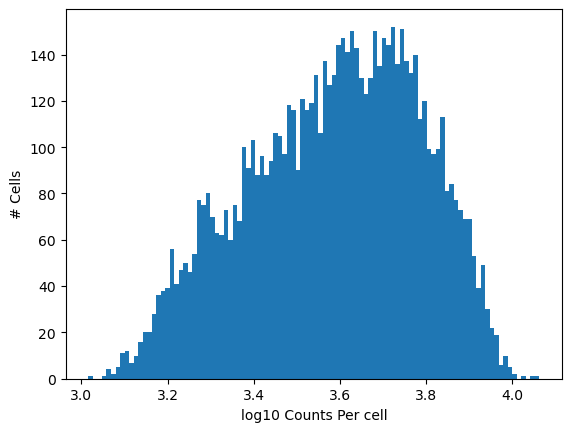

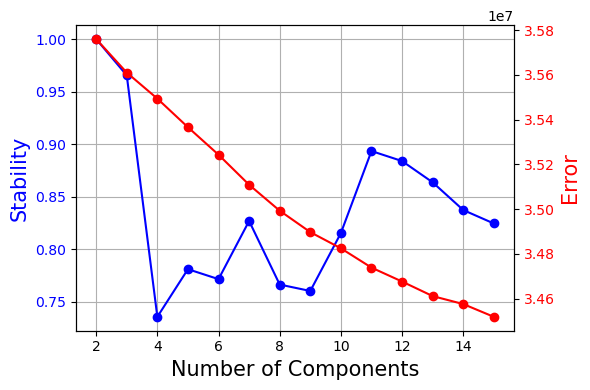

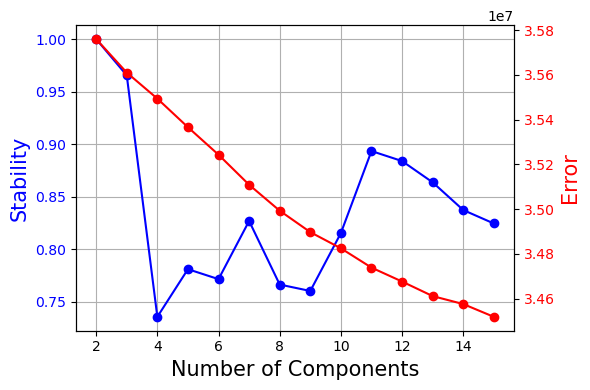

In [89]:
# Load in the naive data
cis = sc.read_h5ad('cis.h5ad')
## plot log10 # counts per cell
plt.hist(np.log10(cis.obs['nCount_RNA']), bins=100)
_ = plt.xlabel('log10 Counts Per cell')
_ = plt.ylabel('# Cells')

if not os.path.exists('cis'):
    os.mkdir('cis')

cis.layers['counts'] = cis.raw.X.copy()
cis.layers['log1p'] = cis.X.copy()

count_adat_fn = 'cis/cis_counts.h5ad'
sc.write(count_adat_fn, cis)


cis_dense_data = pd.DataFrame(cis.layers['counts'].todense(), index=cis.obs.index, columns=cis.var.index).astype(int)
cis_dense_data.head()
count_txt_fn = 'cis/counts.tsv'
cis_dense_data.to_csv(count_txt_fn, sep='\t')

numiter=200 # Number of NMF replicates. Set this to a larger value ~200 for real data. We set this to a relatively low value here for illustration at a faster speed
numhvgenes=5000 ## Number of over-dispersed genes to use for running the actual factorizations

## Results will be saved to [output_directory]/[run_name] which in this example is example_PBMC/cNMF/pbmc_cNMF
output_directory = 'cis'
if not os.path.exists(output_directory):
    os.mkdir(output_directory)
run_name = 'cis_cNMF'

## Specify the Ks to use as a space separated list in this case "2 3 4 5 6 7 8 9 10"
K = ' '.join([str(i) for i in range(2,16)])

## To speed this up, you can run it for only K=7-8 with the option below
#K = ' '.join([str(i) for i in range(7,9)])


seed = 14 ## Specify a seed pseudorandom number generation for reproducibility

## Path to the filtered counts dataset we output previously
countfn = 'cis/cis_counts.h5ad'

## Initialize the cnmf object that will be used to run analyses
cis_cnmf_obj = cNMF(output_dir=output_directory, name=run_name)

## Prepare the data, I.e. subset to 5000 high-variance genes, and variance normalize
cis_cnmf_obj.prepare(counts_fn=count_txt_fn, components=np.arange(2,16), n_iter=200, seed=14, num_highvar_genes=5000)

## Specify that the jobs are being distributed over a single worker (total_workers=1) and then launch that worker
cis_cnmf_obj.factorize(worker_i=0, total_workers=1)

# Combine the individual factorizations
cis_cnmf_obj.combine()
# Compute the stability at each choice of K to see if a clear choice jumps out
cis_cnmf_obj.k_selection_plot(close_fig=False)

print('This saves the corresponding figure to the following file: %s' % cis_cnmf_obj.paths['k_selection_plot'])
# Combine the individual factorizations
cis_cnmf_obj.combine()

# Compute the stability at each choice of K to see if a clear choice jumps out
cis_cnmf_obj.k_selection_plot(close_fig=False)
print('This saves the corresponding figure to the following file: %s' % cis_cnmf_obj.paths['k_selection_plot'])

/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/cnmf/cnmf.py:835: RuntimeWarning: invalid value encountered in true_divide
  norm_tpm = (np.array(tpm.X.todense()) - tpm_stats['__mean'].values) / tpm_stats['__std'].values
/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


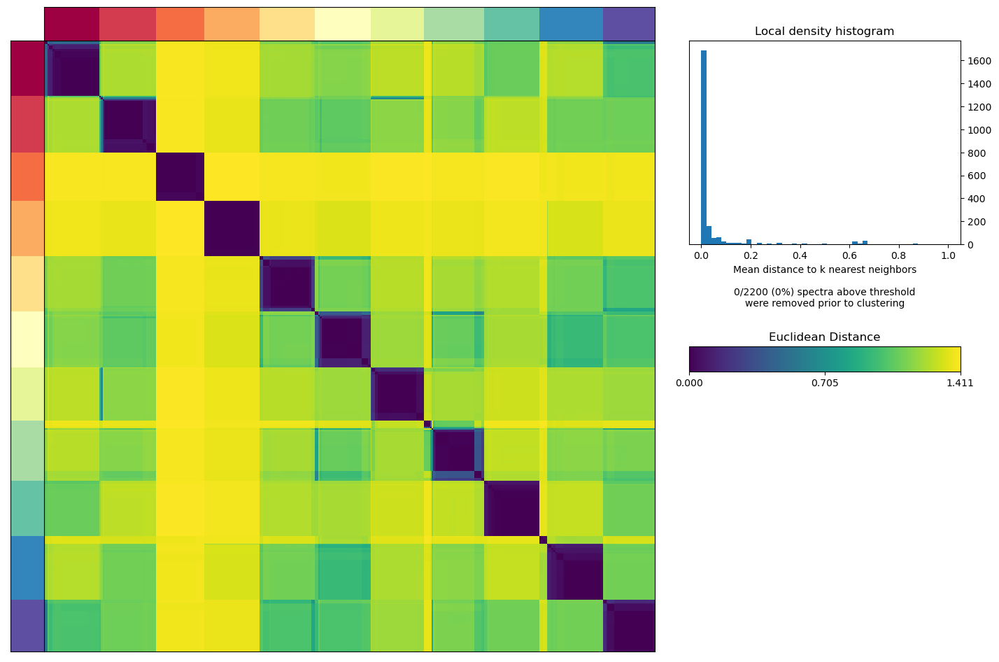

In [156]:
#find k with best stability
selected_K = 11
density_threshold = 2.00   
cis_cnmf_obj.consensus(k=selected_K, density_threshold=density_threshold, show_clustering=True, close_clustergram_fig=False)





/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/cnmf/cnmf.py:835: RuntimeWarning: invalid value encountered in true_divide
  norm_tpm = (np.array(tpm.X.todense()) - tpm_stats['__mean'].values) / tpm_stats['__std'].values
/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


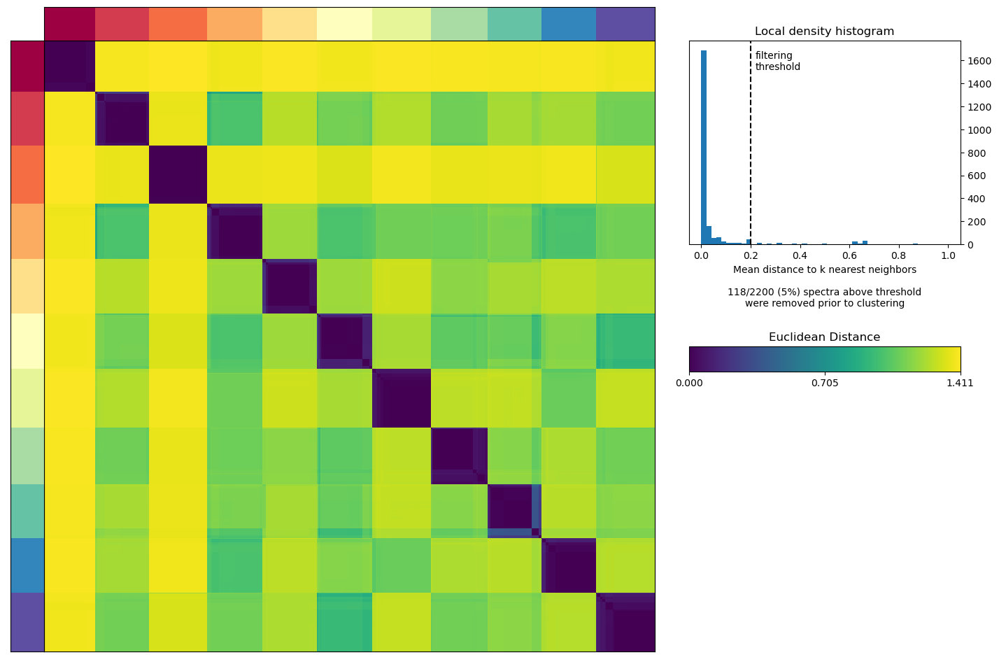

In [157]:
# Try increasingly stringent filters
density_threshold = 0.2
cis_cnmf_obj.consensus(k=selected_K, density_threshold=density_threshold, show_clustering=True, close_clustergram_fig=False)






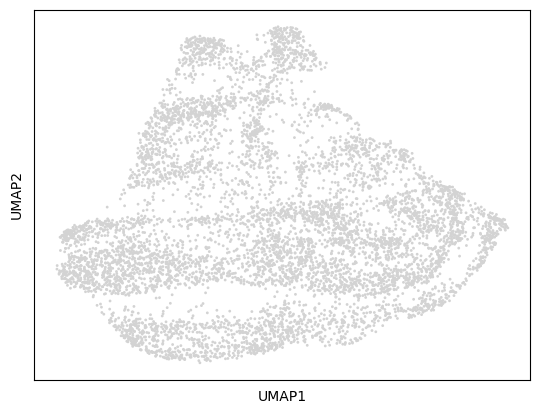

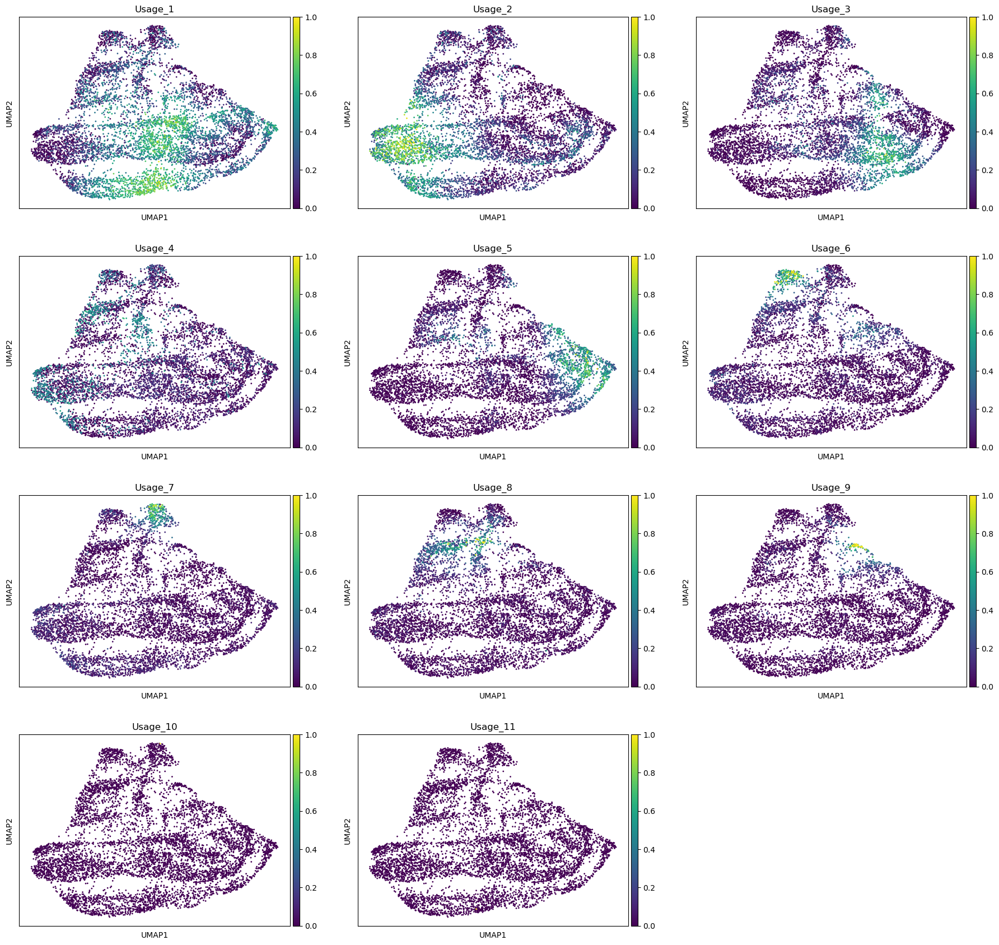

In [101]:
## Obtain high variance genes that were used for cNMF as these were saved to a text file
cis_hvgs = open('./cis/cis_cNMF/cis_cNMF.overdispersed_genes.txt').read().split('\n')
# Verify that the the naive umap is plotting correctly
sc.pl.umap(cis)
# We can load the results for a cNMF run with a given K and density filtering threshold like below
usage_norm, gep_scores, gep_tpm, topgenes = cis_cnmf_obj.load_results(K=selected_K, density_threshold=density_threshold)
usage_norm.columns = ['Usage%d' % i for i in usage_norm.columns]

gep_scores.to_csv('cis/cis_gep_scores.txt', sep='\t', index = True)

# Lets look at how the normalized usages segregate on the UMAP
cis.obs = pd.merge(left=cis.obs, right=usage_norm, how='left', left_index=True, right_index=True)

sc.pl.umap(cis, color=usage_norm.columns,
           use_raw=True, ncols=3, vmin=0, vmax=1)
top_genes = []
ngenes = 100
for gep in gep_scores.columns:
    top_genes.append(list(gep_scores.sort_values(by=gep, ascending=False).index[:ngenes]))
    
top_genes = pd.DataFrame(top_genes, index=gep_scores.columns).T
top_genes

topgenes.to_csv('cis/cis_topgenes.txt', sep='\t', index = False)

Doxorubicin

/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/anndata/compat/__init__.py:235: FutureWarning: Moving element from .uns['neighbors']['distances'] to .obsp['distances'].

This is where adjacency matrices should go now.
  FutureWarning,
/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/cnmf/cnmf.py:327: FutureWarning: X.dtype being converted to np.float32 from int64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  var=pd.DataFrame(index=input_counts.columns))
/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


[Worker 0]. Starting task 0.
[Worker 0]. Starting task 1.
[Worker 0]. Starting task 2.
[Worker 0]. Starting task 3.
[Worker 0]. Starting task 4.
[Worker 0]. Starting task 5.
[Worker 0]. Starting task 6.
[Worker 0]. Starting task 7.
[Worker 0]. Starting task 8.
[Worker 0]. Starting task 9.
[Worker 0]. Starting task 10.
[Worker 0]. Starting task 11.
[Worker 0]. Starting task 12.
[Worker 0]. Starting task 13.
[Worker 0]. Starting task 14.
[Worker 0]. Starting task 15.
[Worker 0]. Starting task 16.
[Worker 0]. Starting task 17.
[Worker 0]. Starting task 18.
[Worker 0]. Starting task 19.
[Worker 0]. Starting task 20.
[Worker 0]. Starting task 21.
[Worker 0]. Starting task 22.
[Worker 0]. Starting task 23.
[Worker 0]. Starting task 24.
[Worker 0]. Starting task 25.
[Worker 0]. Starting task 26.
[Worker 0]. Starting task 27.
[Worker 0]. Starting task 28.
[Worker 0]. Starting task 29.
[Worker 0]. Starting task 30.
[Worker 0]. Starting task 31.
[Worker 0]. Starting task 32.
[Worker 0]. Starting

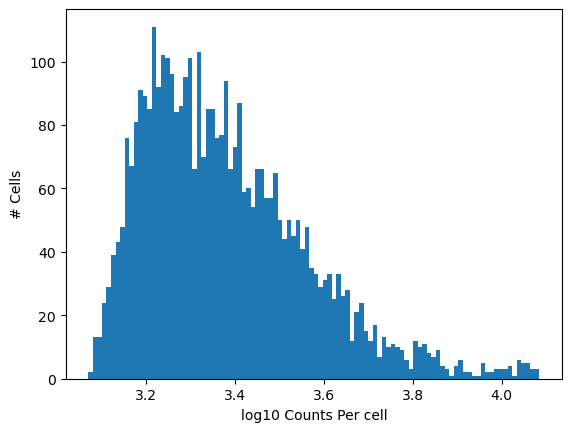

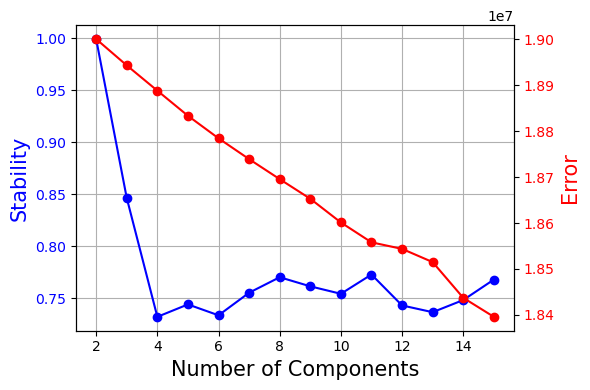

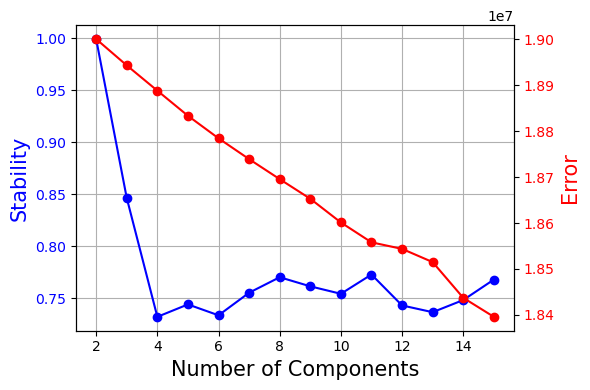

In [90]:
# Load in the naive data
dox = sc.read_h5ad('dox.h5ad')
## plot log10 # counts per cell
plt.hist(np.log10(dox.obs['nCount_RNA']), bins=100)
_ = plt.xlabel('log10 Counts Per cell')
_ = plt.ylabel('# Cells')

if not os.path.exists('dox'):
    os.mkdir('dox')

dox.layers['counts'] = dox.raw.X.copy()
dox.layers['log1p'] = dox.X.copy()

count_adat_fn = 'dox/dox_counts.h5ad'
sc.write(count_adat_fn, dox)


dox_dense_data = pd.DataFrame(dox.layers['counts'].todense(), index=dox.obs.index, columns=dox.var.index).astype(int)
dox_dense_data.head()
count_txt_fn = 'dox/counts.tsv'
dox_dense_data.to_csv(count_txt_fn, sep='\t')

numiter=200 # Number of NMF replicates. Set this to a larger value ~200 for real data. We set this to a relatively low value here for illustration at a faster speed
numhvgenes=5000 ## Number of over-dispersed genes to use for running the actual factorizations

## Results will be saved to [output_directory]/[run_name] which in this example is example_PBMC/cNMF/pbmc_cNMF
output_directory = 'dox'
if not os.path.exists(output_directory):
    os.mkdir(output_directory)
run_name = 'dox_cNMF'

## Specify the Ks to use as a space separated list in this case "2 3 4 5 6 7 8 9 10"
K = ' '.join([str(i) for i in range(2,16)])

## To speed this up, you can run it for only K=7-8 with the option below
#K = ' '.join([str(i) for i in range(7,9)])


seed = 14 ## Specify a seed pseudorandom number generation for reproducibility

## Path to the filtered counts dataset we output previously
countfn = 'dox/dox_counts.h5ad'

## Initialize the cnmf object that will be used to run analyses
dox_cnmf_obj = cNMF(output_dir=output_directory, name=run_name)

## Prepare the data, I.e. subset to 5000 high-variance genes, and variance normalize
dox_cnmf_obj.prepare(counts_fn=count_txt_fn, components=np.arange(2,16), n_iter=200, seed=14, num_highvar_genes=5000)

## Specify that the jobs are being distributed over a single worker (total_workers=1) and then launch that worker
dox_cnmf_obj.factorize(worker_i=0, total_workers=1)

# Combine the individual factorizations
dox_cnmf_obj.combine()
# Compute the stability at each choice of K to see if a clear choice jumps out
dox_cnmf_obj.k_selection_plot(close_fig=False)

print('This saves the corresponding figure to the following file: %s' % dox_cnmf_obj.paths['k_selection_plot'])
# Combine the individual factorizations
dox_cnmf_obj.combine()

# Compute the stability at each choice of K to see if a clear choice jumps out
dox_cnmf_obj.k_selection_plot(close_fig=False)
print('This saves the corresponding figure to the following file: %s' % dox_cnmf_obj.paths['k_selection_plot'])

/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/cnmf/cnmf.py:835: RuntimeWarning: invalid value encountered in true_divide
  norm_tpm = (np.array(tpm.X.todense()) - tpm_stats['__mean'].values) / tpm_stats['__std'].values
/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


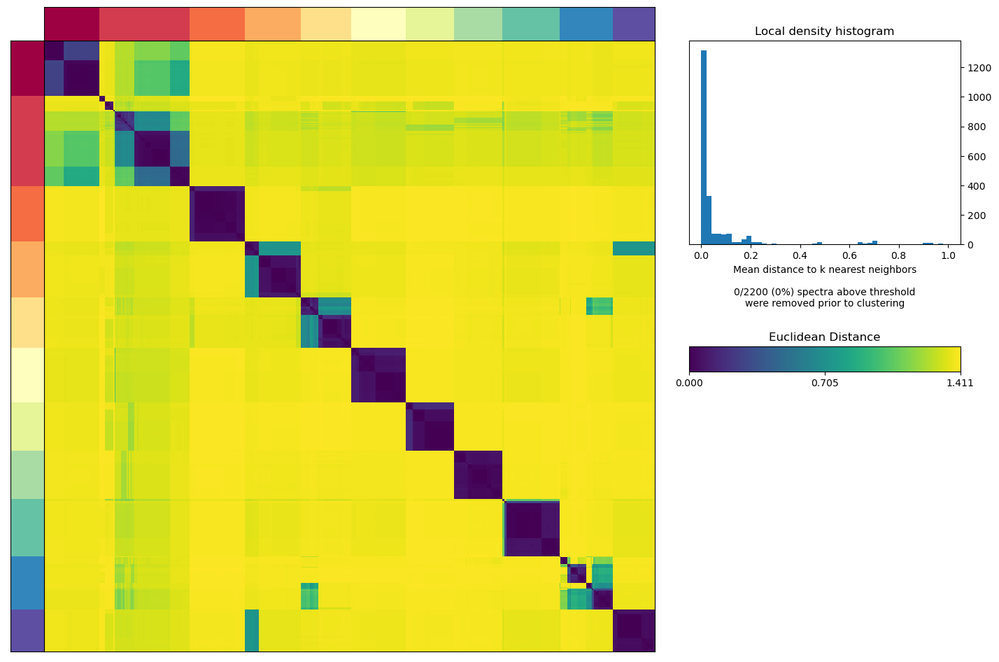

In [159]:
#find k with best stability
selected_K = 11
density_threshold = 2.00   
dox_cnmf_obj.consensus(k=selected_K, density_threshold=density_threshold, show_clustering=True, close_clustergram_fig=False)






/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/cnmf/cnmf.py:835: RuntimeWarning: invalid value encountered in true_divide
  norm_tpm = (np.array(tpm.X.todense()) - tpm_stats['__mean'].values) / tpm_stats['__std'].values
/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


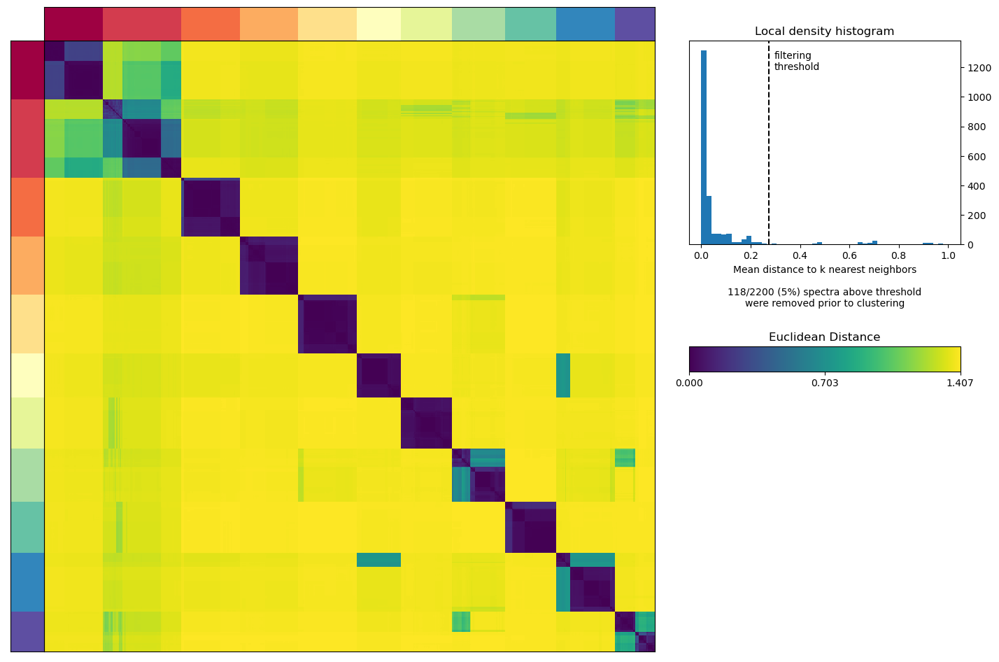

In [160]:
# Try increasingly stringent filters
density_threshold = 0.275
dox_cnmf_obj.consensus(k=selected_K, density_threshold=density_threshold, show_clustering=True, close_clustergram_fig=False)







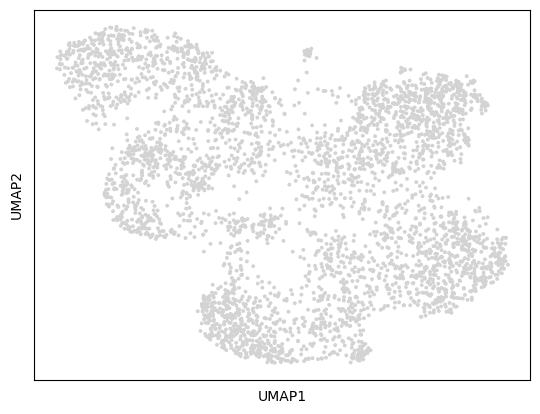

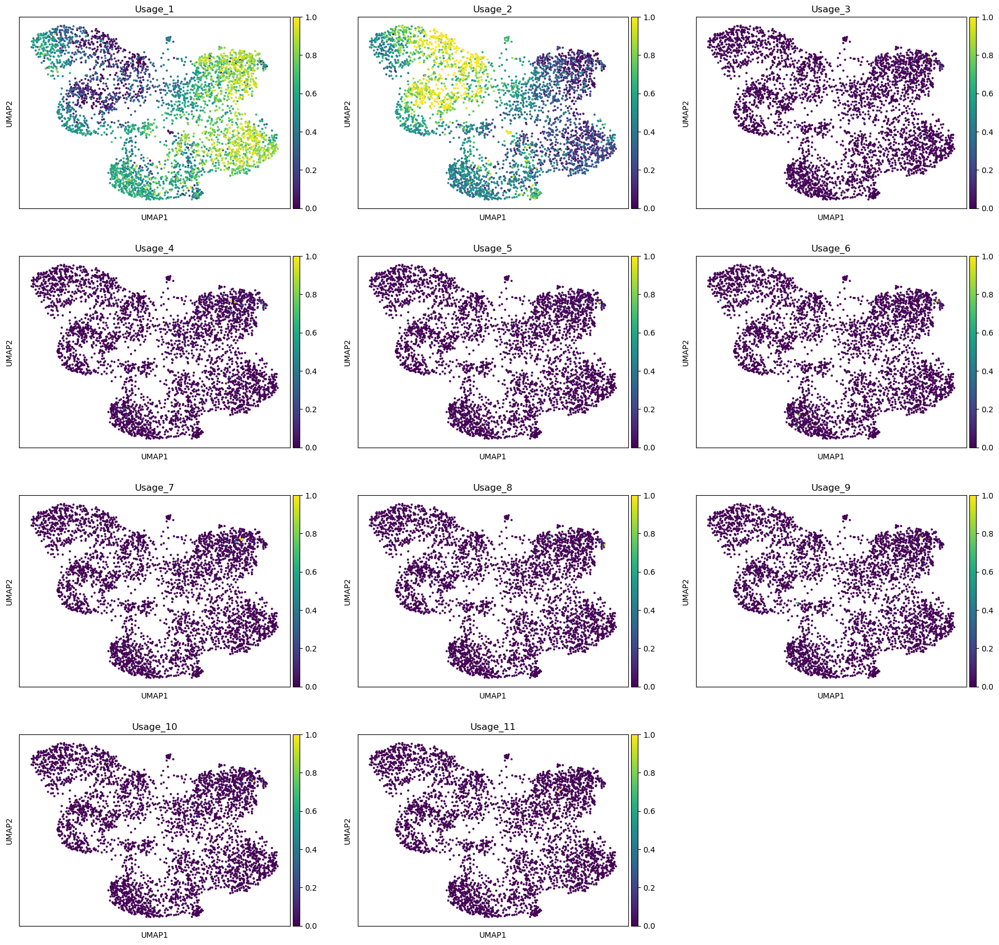

In [107]:
## Obtain high variance genes that were used for cNMF as these were saved to a text file
dox_hvgs = open('./dox/dox_cNMF/dox_cNMF.overdispersed_genes.txt').read().split('\n')
# Verify that the the naive umap is plotting correctly
sc.pl.umap(dox)
# We can load the results for a cNMF run with a given K and density filtering threshold like below
usage_norm, gep_scores, gep_tpm, topgenes = dox_cnmf_obj.load_results(K=selected_K, density_threshold=density_threshold)
usage_norm.columns = ['Usage%d' % i for i in usage_norm.columns]

gep_scores.to_csv('dox/dox_gep_scores.txt', sep='\t', index = True)

# Lets look at how the normalized usages segregate on the UMAP
dox.obs = pd.merge(left=dox.obs, right=usage_norm, how='left', left_index=True, right_index=True)

sc.pl.umap(dox, color=usage_norm.columns,
           use_raw=True, ncols=3, vmin=0, vmax=1)
top_genes = []
ngenes = 100
for gep in gep_scores.columns:
    top_genes.append(list(gep_scores.sort_values(by=gep, ascending=False).index[:ngenes]))
    
top_genes = pd.DataFrame(top_genes, index=gep_scores.columns).T
top_genes

topgenes.to_csv('dox/dox_topgenes.txt', sep='\t', index = False)

all_data

/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/anndata/compat/__init__.py:235: FutureWarning: Moving element from .uns['neighbors']['distances'] to .obsp['distances'].

This is where adjacency matrices should go now.
  FutureWarning,
/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/cnmf/cnmf.py:327: FutureWarning: X.dtype being converted to np.float32 from int64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  var=pd.DataFrame(index=input_counts.columns))
/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


[Worker 0]. Starting task 0.
[Worker 0]. Starting task 1.
[Worker 0]. Starting task 2.
[Worker 0]. Starting task 3.
[Worker 0]. Starting task 4.
[Worker 0]. Starting task 5.
[Worker 0]. Starting task 6.
[Worker 0]. Starting task 7.
[Worker 0]. Starting task 8.
[Worker 0]. Starting task 9.
[Worker 0]. Starting task 10.
[Worker 0]. Starting task 11.
[Worker 0]. Starting task 12.
[Worker 0]. Starting task 13.
[Worker 0]. Starting task 14.
[Worker 0]. Starting task 15.
[Worker 0]. Starting task 16.
[Worker 0]. Starting task 17.
[Worker 0]. Starting task 18.
[Worker 0]. Starting task 19.
[Worker 0]. Starting task 20.
[Worker 0]. Starting task 21.
[Worker 0]. Starting task 22.
[Worker 0]. Starting task 23.
[Worker 0]. Starting task 24.
[Worker 0]. Starting task 25.
[Worker 0]. Starting task 26.
[Worker 0]. Starting task 27.
[Worker 0]. Starting task 28.
[Worker 0]. Starting task 29.
[Worker 0]. Starting task 30.
[Worker 0]. Starting task 31.
[Worker 0]. Starting task 32.
[Worker 0]. Starting

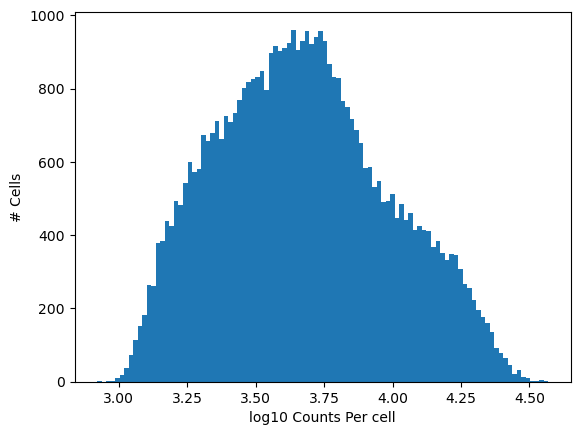

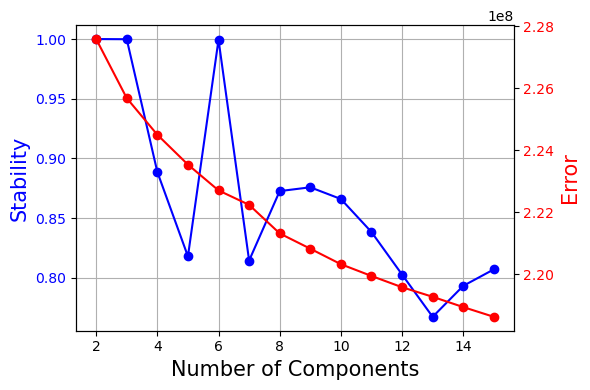

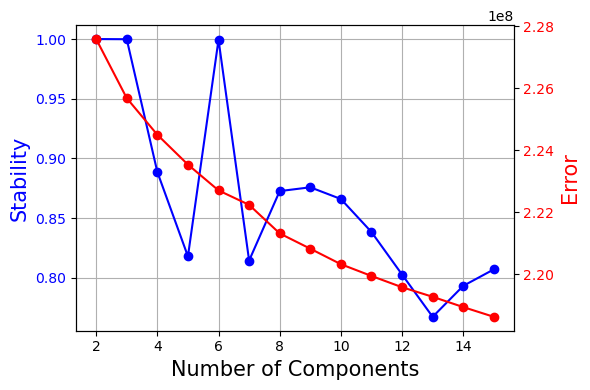

In [121]:
# Load in the naive data
all_data = sc.read_h5ad('all_data.h5ad')
## plot log10 # counts per cell
plt.hist(np.log10(all_data.obs['nCount_RNA']), bins=100)
_ = plt.xlabel('log10 Counts Per cell')
_ = plt.ylabel('# Cells')

if not os.path.exists('all_data'):
    os.mkdir('all_data')

all_data.layers['counts'] = all_data.raw.X.copy()
all_data.layers['log1p'] = all_data.X.copy()

count_adat_fn = 'all_data/all_data_counts.h5ad'
sc.write(count_adat_fn, all_data)


all_data_dense_data = pd.DataFrame(all_data.layers['counts'].todense(), index=all_data.obs.index, columns=all_data.var.index).astype(int)
all_data_dense_data.head()
count_txt_fn = 'all_data/counts.tsv'
all_data_dense_data.to_csv(count_txt_fn, sep='\t')

numiter=200 # Number of NMF replicates. Set this to a larger value ~200 for real data. We set this to a relatively low value here for illustration at a faster speed
numhvgenes=5000 ## Number of over-dispersed genes to use for running the actual factorizations

## Results will be saved to [output_directory]/[run_name] which in this example is example_PBMC/cNMF/pbmc_cNMF
output_directory = 'all_data'
if not os.path.exists(output_directory):
    os.mkdir(output_directory)
run_name = 'all_data_cNMF'

## Specify the Ks to use as a space separated list in this case "2 3 4 5 6 7 8 9 10"
K = ' '.join([str(i) for i in range(2,16)])

## To speed this up, you can run it for only K=7-8 with the option below
#K = ' '.join([str(i) for i in range(7,9)])


seed = 14 ## Specify a seed pseudorandom number generation for reproducibility

## Path to the filtered counts dataset we output previously
countfn = 'all_data/all_data_counts.h5ad'

## Initialize the cnmf object that will be used to run analyses
all_data_cnmf_obj = cNMF(output_dir=output_directory, name=run_name)

## Prepare the data, I.e. subset to 5000 high-variance genes, and variance normalize
all_data_cnmf_obj.prepare(counts_fn=count_txt_fn, components=np.arange(2,16), n_iter=200, seed=14, num_highvar_genes=5000)

## Specify that the jobs are being distributed over a single worker (total_workers=1) and then launch that worker
all_data_cnmf_obj.factorize(worker_i=0, total_workers=1)

# Combine the individual factorizations
all_data_cnmf_obj.combine()
# Compute the stability at each choice of K to see if a clear choice jumps out
all_data_cnmf_obj.k_selection_plot(close_fig=False)

print('This saves the corresponding figure to the following file: %s' % all_data_cnmf_obj.paths['k_selection_plot'])
# Combine the individual factorizations
all_data_cnmf_obj.combine()

# Compute the stability at each choice of K to see if a clear choice jumps out
all_data_cnmf_obj.k_selection_plot(close_fig=False)
print('This saves the corresponding figure to the following file: %s' % all_data_cnmf_obj.paths['k_selection_plot'])

/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/cnmf/cnmf.py:835: RuntimeWarning: invalid value encountered in true_divide
  norm_tpm = (np.array(tpm.X.todense()) - tpm_stats['__mean'].values) / tpm_stats['__std'].values
/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


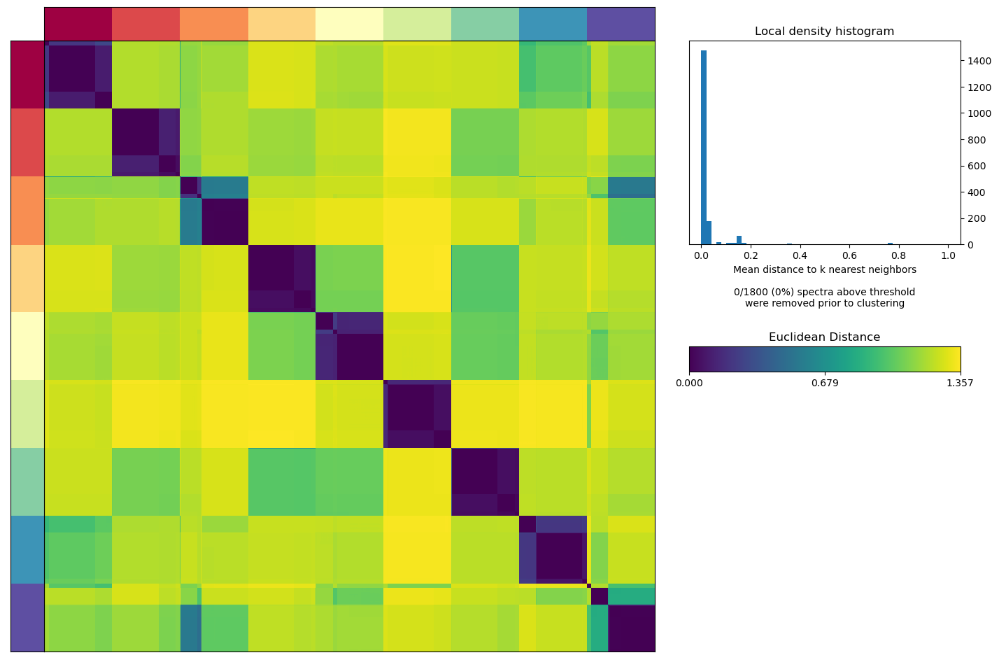

In [162]:
#find k with best stability
selected_K = 9
density_threshold = 2.00   
all_data_cnmf_obj.consensus(k=selected_K, density_threshold=density_threshold, show_clustering=True, close_clustergram_fig=False)




/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/cnmf/cnmf.py:835: RuntimeWarning: invalid value encountered in true_divide
  norm_tpm = (np.array(tpm.X.todense()) - tpm_stats['__mean'].values) / tpm_stats['__std'].values
/Users/dylanschaff/anaconda3/envs/cnmf_env/lib/python3.7/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


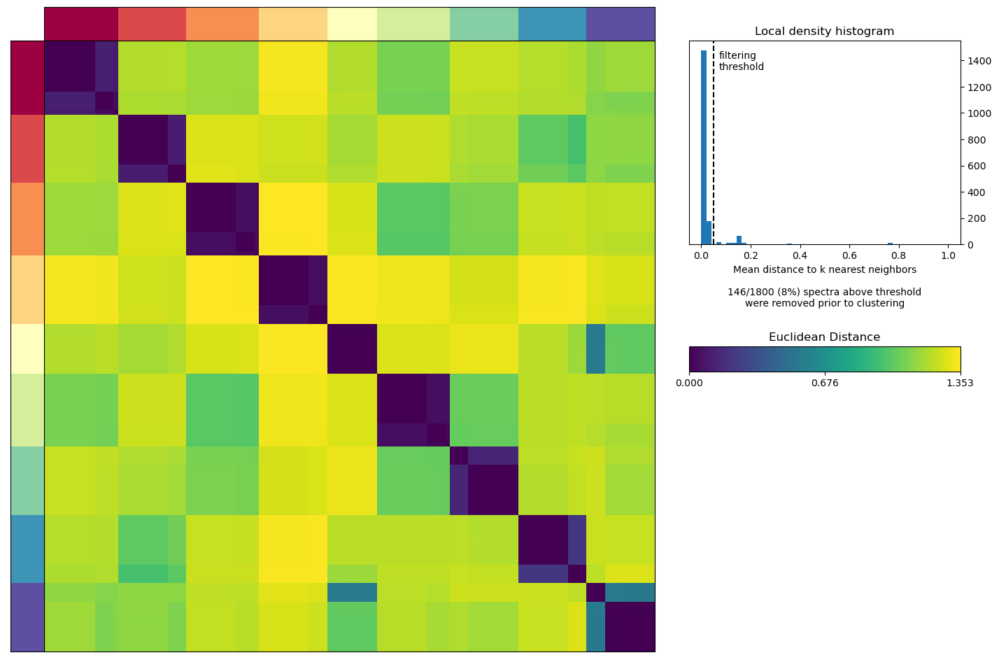

In [163]:
# Try increasingly stringent filters
density_threshold = 0.05
all_data_cnmf_obj.consensus(k=selected_K, density_threshold=density_threshold, show_clustering=True, close_clustergram_fig=False)




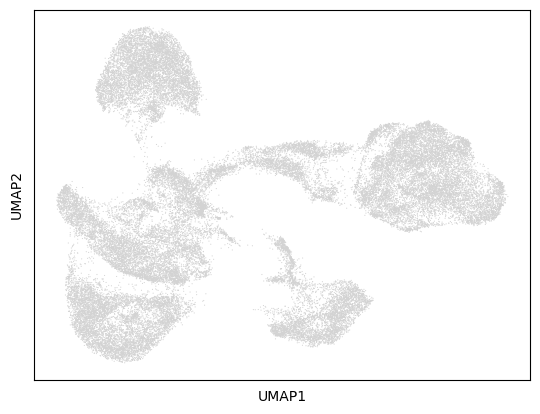

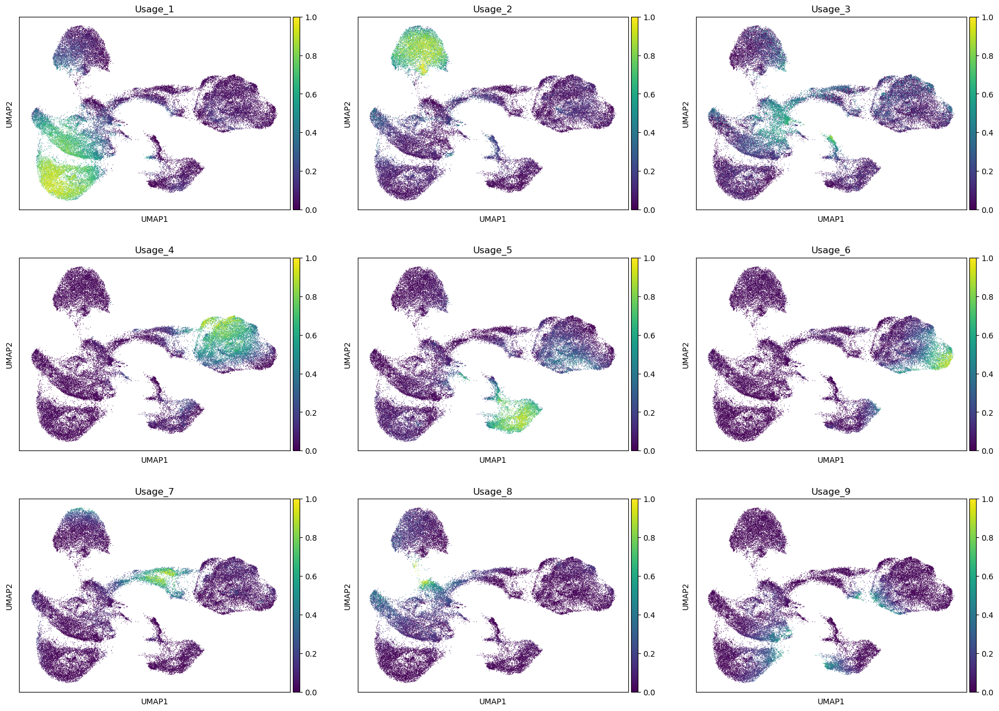

In [87]:
## Obtain high variance genes that were used for cNMF as these were saved to a text file
all_data_hvgs = open('./all_data/all_data_cNMF/all_data_cNMF.overdispersed_genes.txt').read().split('\n')
# Verify that the the naive umap is plotting correctly
sc.pl.umap(all_data)
# We can load the results for a cNMF run with a given K and density filtering threshold like below
usage_norm, gep_scores, gep_tpm, topgenes = all_data_cnmf_obj.load_results(K=selected_K, density_threshold=density_threshold)
usage_norm.columns = ['Usage%d' % i for i in usage_norm.columns]

gep_scores.to_csv('all_data/all_data_gep_scores.txt', sep='\t', index = True)

# Lets look at how the normalized usages segregate on the UMAP
all_data.obs = pd.merge(left=all_data.obs, right=usage_norm, how='left', left_index=True, right_index=True)

sc.pl.umap(all_data, color=usage_norm.columns,
           use_raw=True, ncols=3, vmin=0, vmax=1)
top_genes = []
ngenes = 100
for gep in gep_scores.columns:
    top_genes.append(list(gep_scores.sort_values(by=gep, ascending=False).index[:ngenes]))
    
top_genes = pd.DataFrame(top_genes, index=gep_scores.columns).T
top_genes

topgenes.to_csv('all_data/all_data_topgenes.txt', sep='\t', index = False)